Задание выполнил(а): Кустикова Ульяна

Проблемой коронавируса COVID-19, беспокоившего весь мир на протяжении последних нескольких лет, занимались и занимаются ученые по всему миру. В стороне не осталось и комьюнити Data scientist-ов, которые не только пытались в момент пандемии предсказать ее развитие, но также старались помочь определить наиболее значимые факторы, влияющие на распространение заразы. Например на небезызвестном [Kaggle](https://www.kaggle.com/tags/covid19).

В данном домашнем задании вы попрактикуетесь в анализе и прогнозировании временных рядов, работая с ежедневно обновлявшимися во время пандемии данными из [репозитория](https://github.com/datasets/covid-19), а конкретно [time-series-19-covid-combined.csv](https://github.com/datasets/covid-19/blob/master/data/time-series-19-covid-combined.csv).

In [5]:
import os
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import statsmodels.api as sma
import statsmodels.formula.api as smfa
import statsmodels.tsa.stattools as smstt
%matplotlib inline

pd.options.display.float_format = '{:.2f}'.format

plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (15, 15)

In [6]:
df = pd.read_csv('time-series-19-covid-combined.csv')
df.head()

,Date,Country/Region,Province/State,Confirmed,Recovered,Deaths
0,2020-01-22,Afghanistan,NaN,0,0.00,0
1,2020-01-23,Afghanistan,NaN,0,0.00,0
2,2020-01-24,Afghanistan,NaN,0,0.00,0
3,2020-01-25,Afghanistan,NaN,0,0.00,0
4,2020-01-26,Afghanistan,NaN,0,0.00,0


## Раздел 1. Первичный анализ временных рядов (45 баллов и 15 бонусных баллов)

#### 1.1. (5 баллов) 

Определите границы исследуемого периода, количество заболевших, погибших, выздоровивших. Отобразите на карте распространение болезни. Что вы видите? Какие выводы можно сделать?

In [3]:
df.Date = pd.DatetimeIndex(df.Date)
df.Date.min(), df.Date.max()

(Timestamp('2020-01-22 00:00:00'), Timestamp('2022-04-16 00:00:00'))

Это границы исследуемого периода

In [4]:
Confirmed = df.groupby(df['Country/Region']).Confirmed.max().sum()
Recovered = df.groupby(df['Country/Region']).Recovered.max().sum()
Deaths = df.groupby(df['Country/Region']).Deaths.max().sum()
Confirmed,Recovered,Deaths

(496679936, 135699576.0, 6159555)

Это и есть количество заболевших, выздоровевших и умерших.

In [5]:
df['Country'] = df['Country/Region'].fillna('')
df['State'] = df['Province/State'].fillna('')
df.Recovered = df['Recovered'].fillna(0).apply(int)
df.drop('Country/Region', inplace=True, axis=1)
df.drop('Province/State', inplace=True, axis=1)
df.head()

,Date,Confirmed,Recovered,Deaths,Country,State
0,2020-01-22,0,0,0,Afghanistan,
1,2020-01-23,0,0,0,Afghanistan,
2,2020-01-24,0,0,0,Afghanistan,
3,2020-01-25,0,0,0,Afghanistan,
4,2020-01-26,0,0,0,Afghanistan,


Я изменила вид датасета, чтобы его было легче анализировать, переименовала два столбца, удалила ненужные, заменила NaN на нули для выздоровевших и на пропуски для стран и регионов, также заменила тип на целочисленный для Recovered.

In [6]:
#import libraries
import os, sys
import json
import pandas as pd
import geopandas as gpd
import numpy as np
from numpy import int64
import requests, io
import urllib.request
import fiona
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt


<AxesSubplot: >

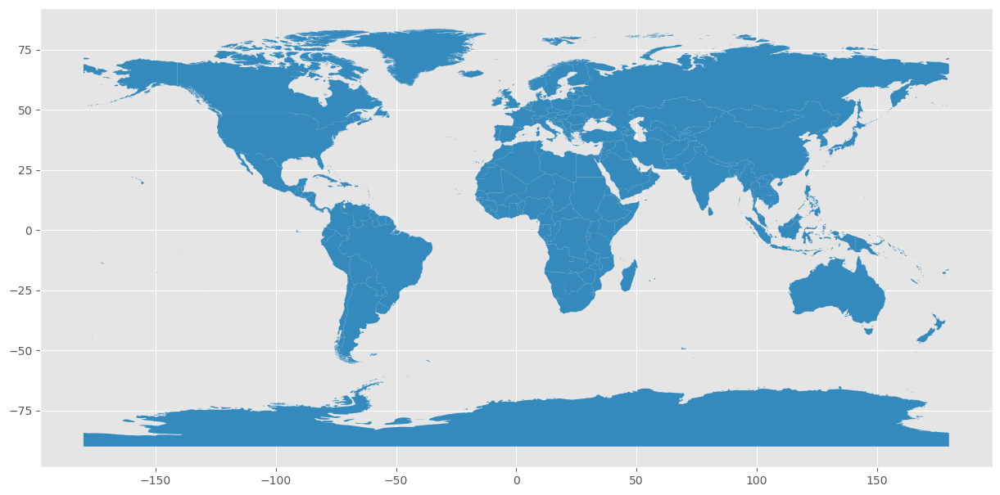

In [7]:
url = "https://opendata.arcgis.com/datasets/a21fdb46d23e4ef896f31475217cbb08_1.geojson"
world = gpd.read_file(url)
world.plot()

In [8]:
df1 = pd.DataFrame(columns=['TotalConfirmed', 'TotalRecovered', 'TotalDeaths'])
df1.TotalConfirmed = df.groupby(df['Country']).Confirmed.max()
df1.TotalRecovered = df.groupby(df['Country']).Recovered.max()
df1.TotalDeaths = df.groupby(df['Country']).Deaths.max()
df1

,TotalConfirmed,TotalRecovered,TotalDeaths
Country,,,
Afghanistan,178387,82586,7676
Albania,274462,130314,3496
Algeria,265739,118409,6874
Andorra,40709,14380,155
Angola,99194,39582,1900
...,...,...,...
West Bank and Gaza,656617,312320,5656
Winter Olympics 2022,535,0,0
Yemen,11817,4251,2148


In [9]:
world.CNTRY_NAME = world.CNTRY_NAME.apply(lambda x: x if  x != 'United States' else 'US')

In [10]:
world['Country'] = world.CNTRY_NAME
world.drop('CNTRY_NAME', inplace=True, axis=1)
corona = world.merge(df, on='Country', how='left')
corona.dtypes

OBJECTID              int64
geometry           geometry
Country              object
Date         datetime64[ns]
Confirmed           float64
Recovered           float64
Deaths              float64
State                object
dtype: object

In [11]:
df_world = pd.merge(df1, world, on="Country")
crs = {"init": "epsg:4326"}
corona_gpd = gpd.GeoDataFrame(df_world, crs=crs, geometry="geometry")
corona_gpd

,Country,TotalConfirmed,TotalRecovered,TotalDeaths,OBJECTID,geometry
0,Afghanistan,178387,82586,7676,3,"POLYGON ((61.27656 35.60725, 61.29638 35.62853..."
1,Albania,274462,130314,3496,6,"POLYGON ((20.79192 40.43154, 20.78722 40.39472..."
2,Algeria,265739,118409,6874,4,"POLYGON ((-5.15213 30.18047, -5.13917 30.19236..."
3,Andorra,40709,14380,155,8,"POLYGON ((1.44583 42.60194, 1.48653 42.65041, ..."
4,Angola,99194,39582,1900,9,"MULTIPOLYGON (((13.09139 -4.63306, 13.09264 -4..."
...,...,...,...,...,...,...
164,Venezuela,522034,294607,5701,238,"MULTIPOLYGON (((-60.25755 7.92157, -60.31973 7..."
165,Vietnam,10417887,54332,42934,240,"MULTIPOLYGON (((106.45821 11.66586, 106.44830 ..."
166,Yemen,11817,4251,2148,249,"MULTIPOLYGON (((48.68639 14.03750, 48.61000 14..."
167,Zambia,318467,189658,3973,250,"POLYGON ((30.21302 -14.98172, 30.21917 -15.096..."


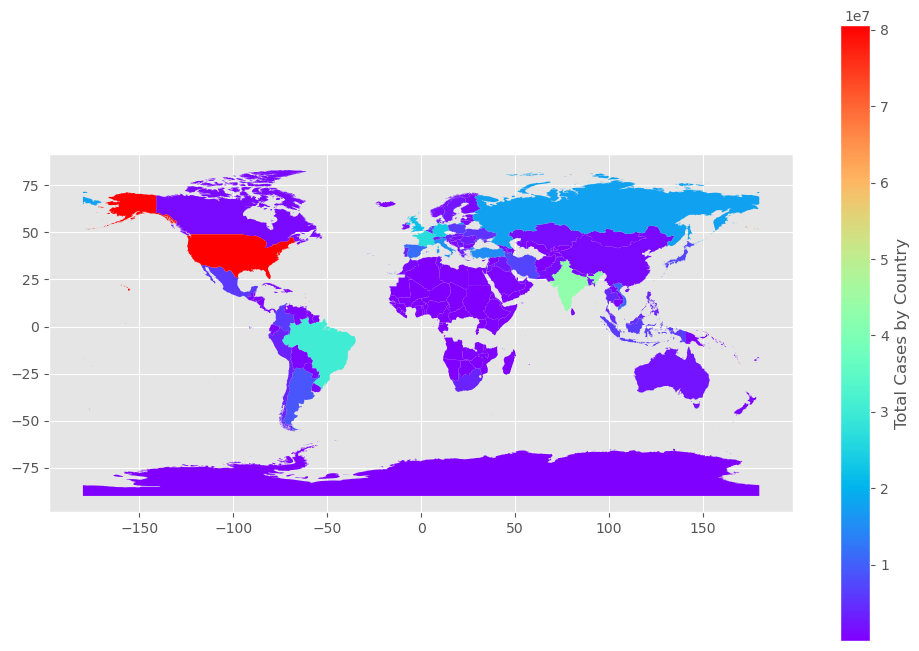

In [12]:
f, ax = plt.subplots(1,1,figsize=(12,8))
ax = corona_gpd.plot(column="TotalConfirmed", cmap="rainbow", ax=ax, legend=True, 
 legend_kwds={"label": "Total Cases by Country" })

Это карта по заболевшим

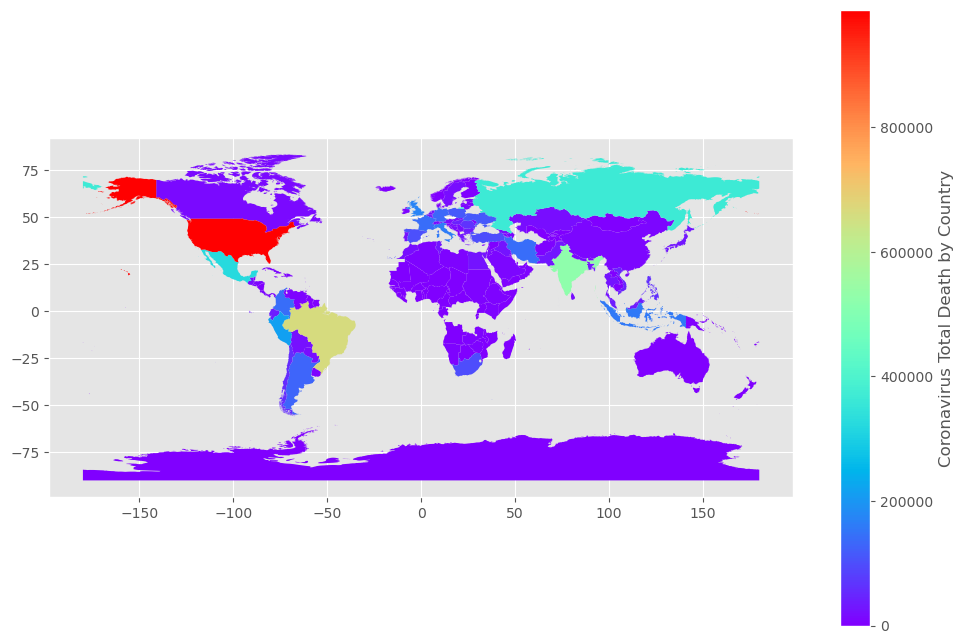

In [13]:
f, ax = plt.subplots(1,1,figsize=(12,8))
ax = corona_gpd.plot(column="TotalDeaths", cmap="rainbow", ax=ax, legend=True, 
 legend_kwds={"label": "Coronavirus Total Death by Country" })


Это карта по количеству умерших от коронавируса. Можно заметить, что больше всего заразившихся было в США,Бразилии, Индии и России, что логично, так как там большое население и невысокий уровень медицины. Больше всего умерших было в США, что тоже понятно по причине высокого процента людей,страдающих ожирением.

#### 1.2. (5 баллов)

Определите количество стран, которые подтвердили случаи заражения 
- на 1 марта 2020 года
- на 1 июня 2020 года
- на 1 октября 2020 года
- на 1 января 2021 года
- на 1 января 2022 года
- на момент окончания исследуемого периода.

Визуализируйте рост количества стран, подтвердивших случаи заражения
- по дням 
- по неделям
- по месяцам. 


Какие выводы можно сделать из этих графиков?

  *Примечание. В анализе временных рядов иногда необходимо изменить частоту дискретизации (Resampling). Такая операция может понадобится, когда имеющихся данных недостаточно или их, наоборот, слишком много. Может не устраивать имеющаяся частота или просто хочется посмотреть на данные с более общего ракурса.*

  *Различают два вида изменения частоты: повышение (Upsampling) и понижение (Downsampling). При повышении временной ряд пересчитывается с низкой частоы на более высокую частоту (например от годовой до месячной частоты). В таком случае процесс включает в себя заполнение или интерполяцию появившихся пропусков в данных. При понижении временной ряд передискретизируется с высокой частоты на низкую (наример с еженедельной на месячную частоту). Это включает в себя агрегацию существующих данных.*

In [14]:
q1 = df[df['Confirmed'] > 0][df['Date'] == '2020-03-01']['Country'].nunique()
q2 = df[df['Confirmed'] > 0][df['Date'] == '2020-06-01']['Country'].nunique()
q3 = df[df['Confirmed'] > 0][df['Date'] == '2020-10-01']['Country'].nunique()
q4 = df[df['Confirmed'] > 0][df['Date'] == '2021-01-01']['Country'].nunique()
q5 = df[df['Confirmed'] > 0][df['Date'] == '2022-01-01']['Country'].nunique()
q6 = df[df['Confirmed'] > 0][df['Date'] == df.Date.max()]['Country'].nunique()
q1,q2,q3,q4,q5,q6

(67, 187, 187, 191, 197, 198)

Можно заметить, что коронавирус быстрее всего распространялся в первые полгода.

<AxesSubplot: title={'center': 'Количество зараженных стран по дням'}, xlabel='Date'>

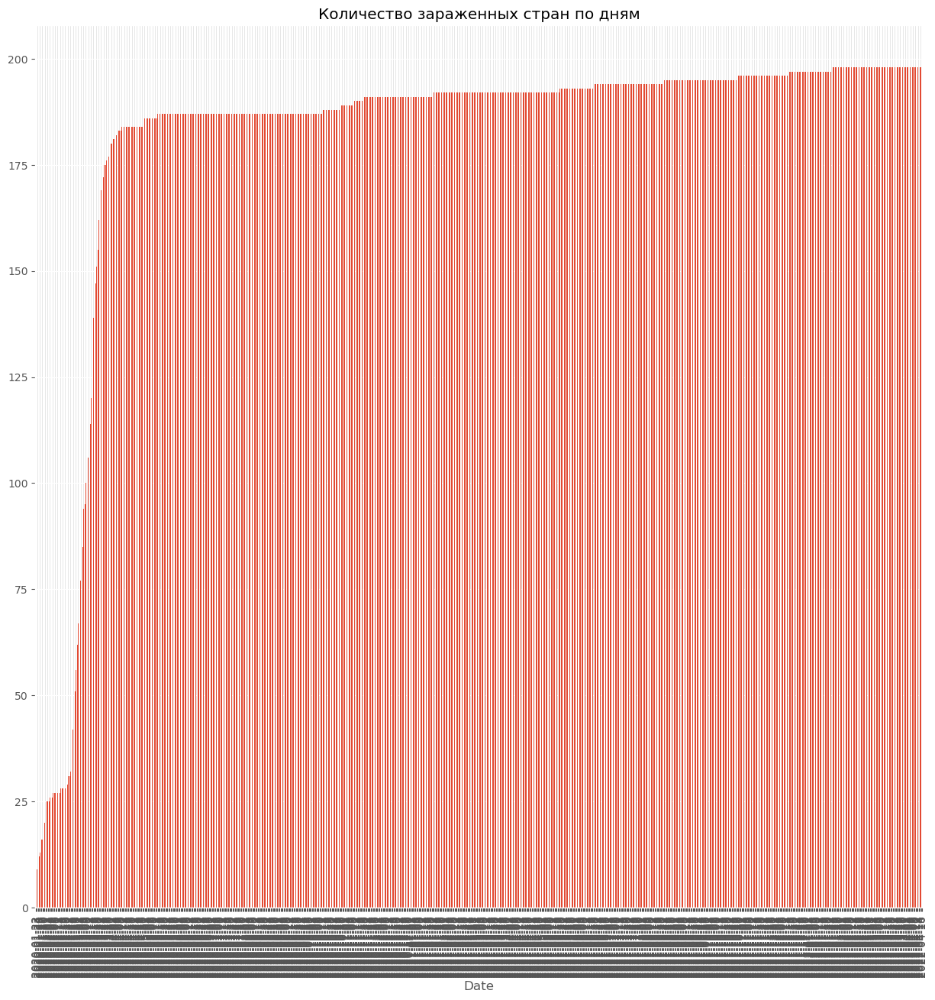

In [15]:
data = df[df['Confirmed'] > 0].groupby('Date')['Country'].nunique()
data.index = data.index.strftime('%Y-%m-%d')
plt.title('Количество зараженных стран по дням')
data.plot.bar()

<AxesSubplot: title={'center': 'Количество зараженных стран по неделям'}, xlabel='Date'>

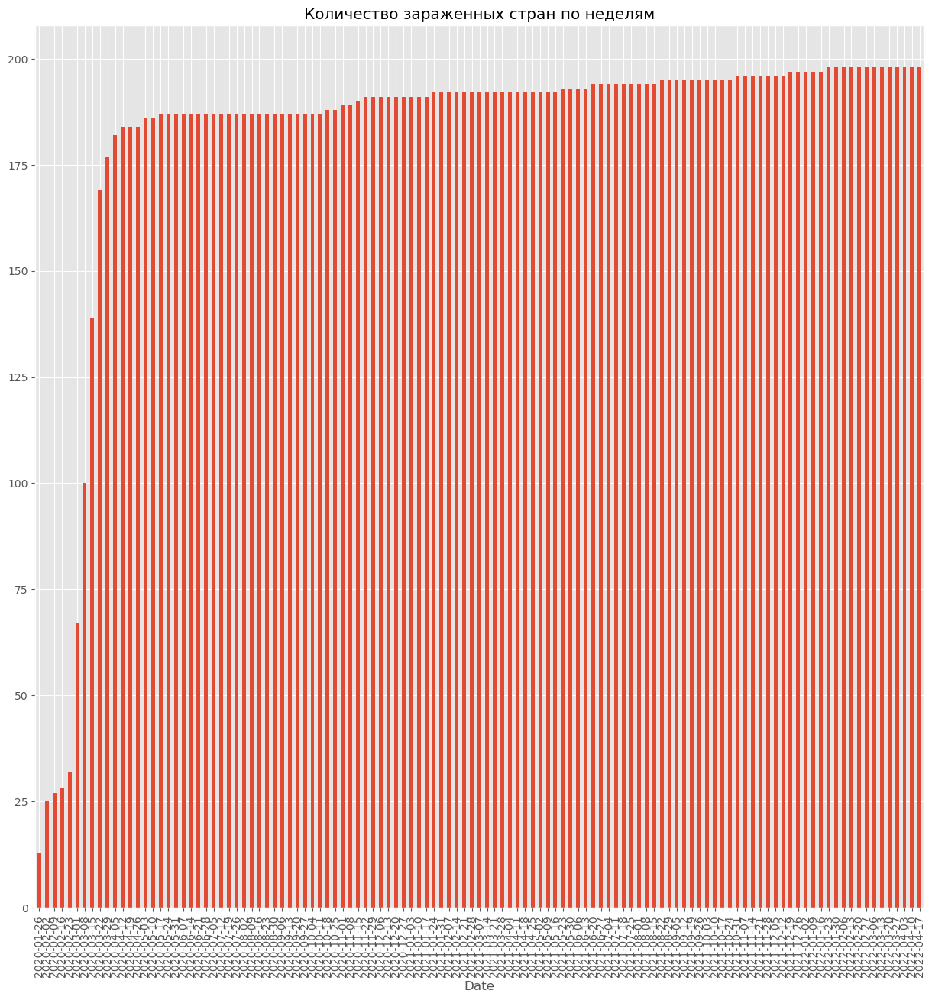

In [16]:
data = df[df['Confirmed'] > 0].groupby(pd.Grouper(key='Date', freq='W'))['Country'].nunique()
data.index = data.index.strftime('%Y-%m-%d')
plt.title('Количество зараженных стран по неделям')
data.plot.bar()

<AxesSubplot: title={'center': 'Количество зараженных стран по месяцам'}, xlabel='Date'>

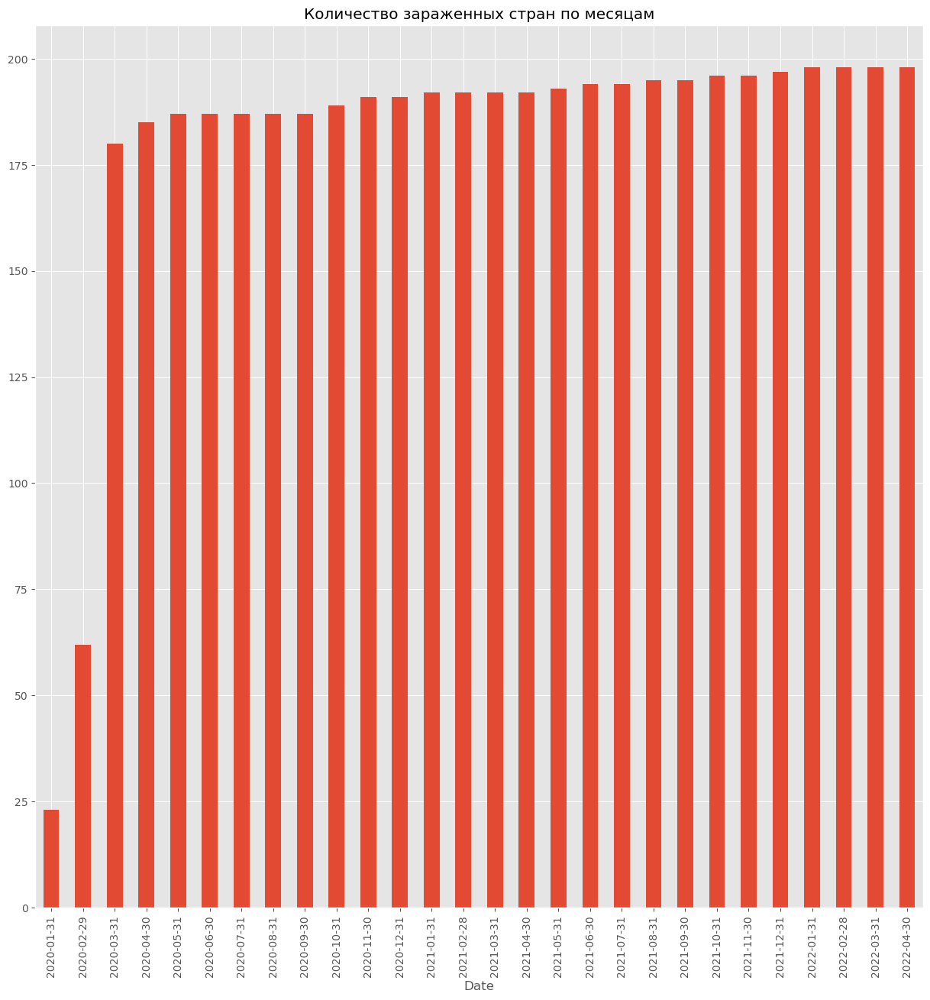

In [17]:
data = df[df['Confirmed'] > 0].groupby(pd.Grouper(key='Date', freq='M'))['Country'].nunique()
data.index = data.index.strftime('%Y-%m-%d')
plt.title('Количество зараженных стран по месяцам')
data.plot.bar()

Можно заметить, что резкий скачок в заражениях произошел буквально за два месяца. Но также сразу понятно, что неудобно анализировать данные по дням, так как временной промежуток слишком большой.

#### 1.3. (5 баллов)

Визуализируйте мировые тренды по числу 

- заболевших 
- погибших 
- выздоровевших.

Постройте графики, которые отражают летальность от вируса 

- в разных странах 
- на разных континентах. 

Какие выводы можно сделать?

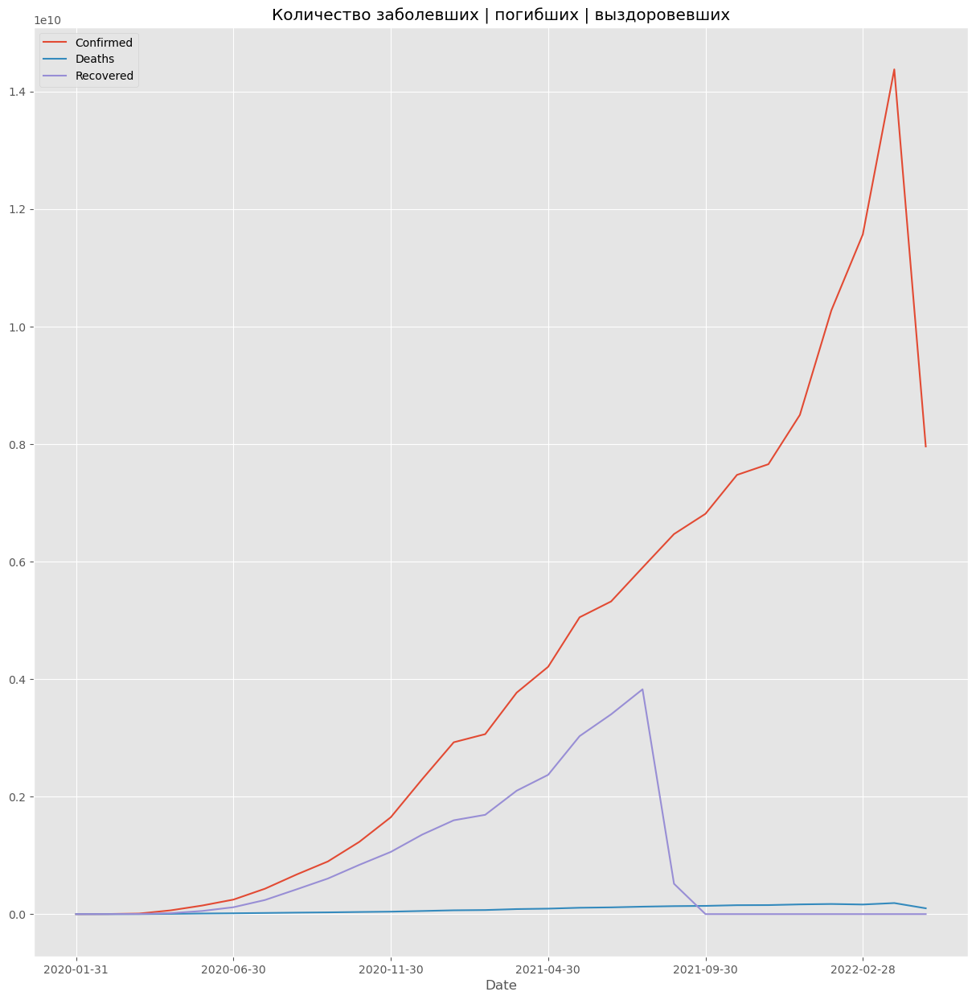

In [18]:
data = df.groupby(pd.Grouper(key='Date', freq='M'))[['Confirmed', 'Deaths', 'Recovered']].sum()
data.index = data.index.strftime('%Y-%m-%d')
data.plot(title='Количество заболевших | погибших | выздоровевших');

In [19]:
import pycountry
countries = []
for country in pycountry.countries:
    countries.append(country.name)

In [20]:
lst = df['Country'].tolist()
false_countries = []
for i in lst:
    if i in countries:
        continue
    else:
        false_countries.append(i)      
set(false_countries)

{'Bolivia',
 'Brunei',
 'Burma',
 'Congo (Brazzaville)',
 'Congo (Kinshasa)',
 "Cote d'Ivoire",
 'Diamond Princess',
 'Holy See',
 'Iran',
 'Korea, South',
 'Kosovo',
 'Laos',
 'MS Zaandam',
 'Micronesia',
 'Moldova',
 'Russia',
 'Summer Olympics 2020',
 'Syria',
 'Taiwan*',
 'Tanzania',
 'US',
 'Venezuela',
 'Vietnam',
 'West Bank and Gaza',
 'Winter Olympics 2022'}

In [21]:
non_countries = ['Winter Olympics 2022','West Bank and Gaza','Summer Olympics 2020','MS Zaandam','Holy See','Diamond Princess','Kosovo','Micronesia','Syria','Taiwan*','Tanzania','Antarctica','Timor-Leste']
country_map = {'US': 'United States', 'Bolivia': 'Bolivia, Plurinational State of', 'Brunei':'Brunei Darussalam','Burma': 'Myanmar', 'Congo (Brazzaville)': 'Congo, The Democratic Republic of the', 'Congo (Kinshasa)': 'Congo', "Cote d'Ivoire":"Côte d'Ivoire",'Iran':'Iran, Islamic Republic of','Korea, South':'Korea, Republic of','Laos':"Lao People's Democratic Republic",'Moldova':'Moldova, Republic of','Russia':'Russian Federation','Venezuela':'Venezuela, Bolivarian Republic of', 'Vietnam': 'Viet Nam'}

for i in non_countries:
    df = df.drop(df[df.Country == i].index)
        
df.Country = df.Country.apply(lambda c: country_map[c] if c in country_map else c)

<AxesSubplot: title={'center': 'Летальность в разных странах'}, ylabel='Country'>

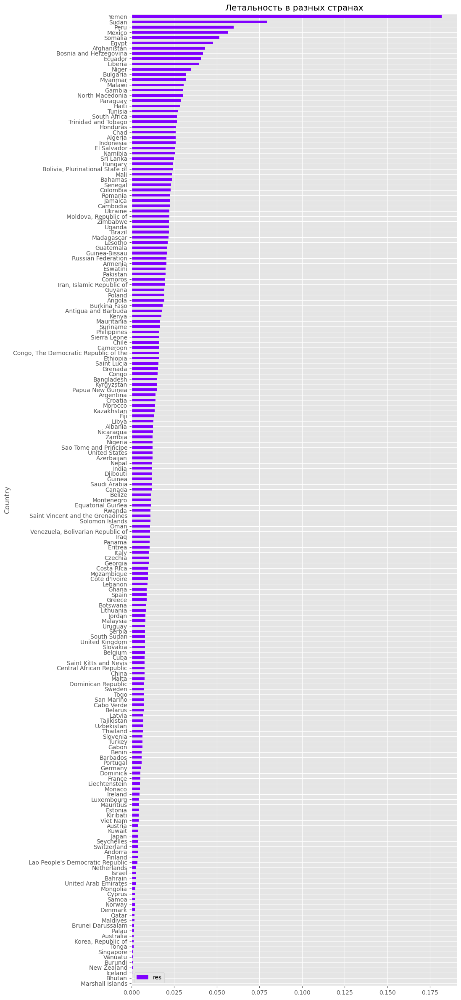

In [22]:
dfDeaths = df.groupby(['Country'], as_index=False)[['Deaths', 'Confirmed']].max()
dfDeaths['res'] = dfDeaths['Deaths'] / dfDeaths['Confirmed']
dfDeaths = dfDeaths.sort_values(by = "res", ascending = True)
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (10, 30)
dfDeaths.plot(kind ="barh", x = 'Country', y = 'res', colormap='rainbow',title = 'Летальность в разных странах')

Я почистила датасет от названий, которые не являются странами и переименовала страны так, чтобы можно было отсортировать их по континентам встроенной библиотекой.

In [23]:
import pycountry_convert as pc

def country_to_continent(country_name):
    country_alpha2 = pc.country_name_to_country_alpha2(country_name)
    country_continent_code = pc.country_alpha2_to_continent_code(country_alpha2)
    country_continent_name = pc.convert_continent_code_to_continent_name(country_continent_code)
    return country_continent_name

# Example
country_name = 'Germany'
print(country_to_continent(country_name))

Europe


In [24]:
df['Continent'] =  df.Country.apply(lambda c: country_to_continent(c))
df

,Date,Confirmed,Recovered,Deaths,Country,State,Continent
0,2020-01-22,0,0,0,Afghanistan,,Asia
1,2020-01-23,0,0,0,Afghanistan,,Asia
2,2020-01-24,0,0,0,Afghanistan,,Asia
3,2020-01-25,0,0,0,Afghanistan,,Asia
4,2020-01-26,0,0,0,Afghanistan,,Asia
...,...,...,...,...,...,...,...
231739,2022-04-12,247094,0,5460,Zimbabwe,,Africa
231740,2022-04-13,247160,0,5460,Zimbabwe,,Africa
231741,2022-04-14,247208,0,5462,Zimbabwe,,Africa
231742,2022-04-15,247237,0,5462,Zimbabwe,,Africa


<AxesSubplot: title={'center': 'Летальность на разных континентах'}, ylabel='Continent'>

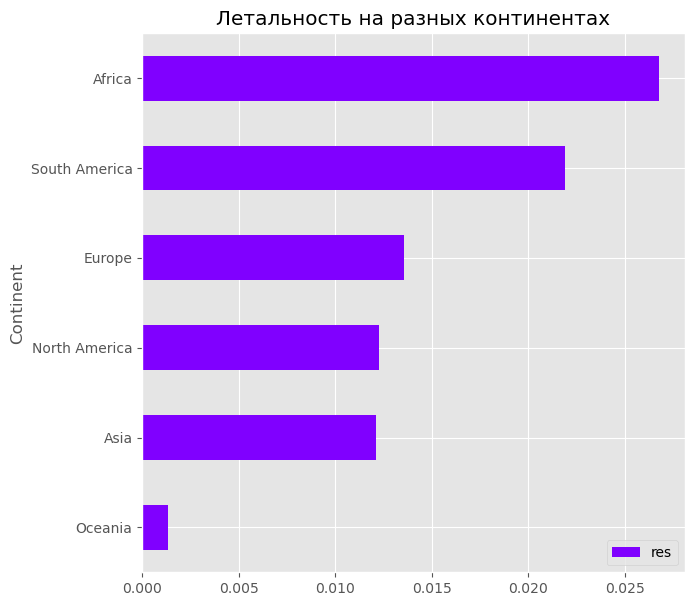

In [25]:
dfDeaths = df.groupby(['Continent'], as_index=False)[['Deaths', 'Confirmed']].max()
dfDeaths['res'] = dfDeaths['Deaths'] / dfDeaths['Confirmed']
dfDeaths = dfDeaths.sort_values(by = "res", ascending = True)
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (7, 7)
dfDeaths.plot(kind ="barh", x = 'Continent', y = 'res', colormap='rainbow',title = 'Летальность на разных континентах')

Самая высокая летальность была в Африке, что связано с плохой медициной, отсутствием вакцины, хорошими условиями для распространения болезни и большим процентом зараженного населения.

#### 1.4. (5 баллов)

Визуализируйте и сравните, как распространялась болезнь в разных странах и на разных континентах по дням с первого зарегистрированного случая заболевания. Определите количество дней для каждой страны со дня первого зарегистрированного случая. Какие тенденции вы видите?

In [26]:
df_spread = df.groupby(['Date', 'Country'])[['Confirmed', 'Recovered', 'Deaths']].sum().reset_index()
df_spread

,Date,Country,Confirmed,Recovered,Deaths
0,2020-01-22,Afghanistan,0,0,0
1,2020-01-22,Albania,0,0,0
2,2020-01-22,Algeria,0,0,0
3,2020-01-22,Andorra,0,0,0
4,2020-01-22,Angola,0,0,0
...,...,...,...,...,...
150955,2022-04-16,"Venezuela, Bolivarian Republic of",522034,0,5701
150956,2022-04-16,Viet Nam,10417887,0,42934
150957,2022-04-16,Yemen,11817,0,2148
150958,2022-04-16,Zambia,318467,0,3973


In [27]:
first_day = df_spread[df_spread['Confirmed'] > 0].groupby('Country')['Date'].min()
df_spread = pd.merge(df_spread[df_spread['Confirmed'] > 0], first_day, on='Country')
df_spread['number_of_day'] = (df_spread['Date_x'] - df_spread['Date_y']).dt.days
df_spread['ill'] = df_spread['Confirmed'] - df_spread['Recovered'] - df_spread['Deaths']
df_spread = df_spread.rename(columns={'Date_y': 'first_day'})
df_spread

,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill
0,2020-01-22,China,548,28,17,2020-01-22,0,503
1,2020-01-23,China,643,30,18,2020-01-22,1,595
2,2020-01-24,China,920,36,26,2020-01-22,2,858
3,2020-01-25,China,1406,39,42,2020-01-22,3,1325
4,2020-01-26,China,2075,49,56,2020-01-22,4,1970
...,...,...,...,...,...,...,...,...
140540,2022-04-12,Tonga,8559,0,11,2021-10-29,165,8548
140541,2022-04-13,Tonga,8761,0,11,2021-10-29,166,8750
140542,2022-04-14,Tonga,8842,0,11,2021-10-29,167,8831
140543,2022-04-15,Tonga,8842,0,11,2021-10-29,168,8831


In [28]:
import plotly.express as px

fig = px.line(df_spread, x="Date_x", y="ill", color='Country',title='Количество болеющих по странам')
fig.update_layout(
    autosize=False,
    width=1000,
    height=500,)
fig.show()

<AxesSubplot: title={'center': 'Количество дней с первого заражения'}, ylabel='Country'>

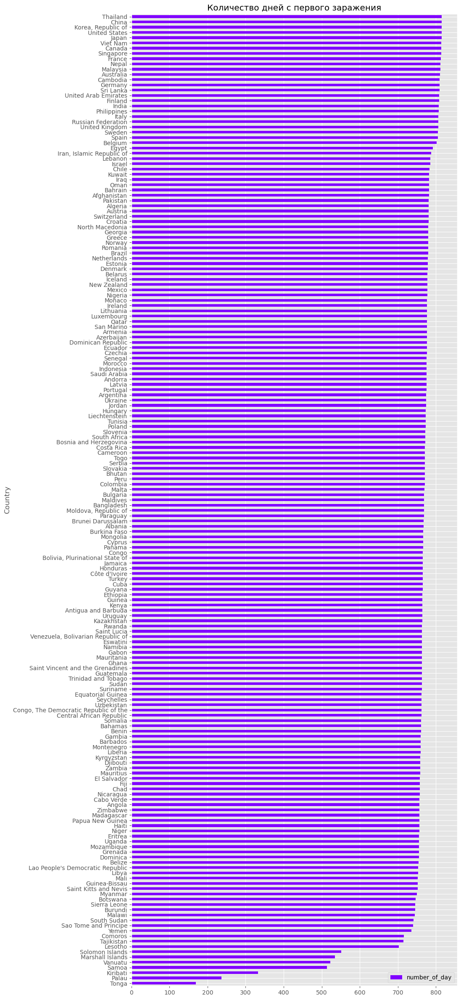

In [29]:
dfDays = df_spread.groupby(['Country'], as_index=False)['number_of_day'].max()
dfDays = dfDays.sort_values(by = "number_of_day", ascending = True)
dfDays
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (10, 30)
dfDays.plot(kind ="barh", x = 'Country', y = 'number_of_day', colormap='rainbow',title = 'Количество дней с первого заражения')

Видно, что коронавирус распространялся очень быстро, так как практически у всех стран одинаковый период с первого дня заражений. США лидирует по количеству активно болеющих людей

In [30]:
df_spread = df.groupby(['Date', 'Continent'])[['Confirmed', 'Recovered', 'Deaths']].sum().reset_index()
df_spread

,Date,Continent,Confirmed,Recovered,Deaths
0,2020-01-22,Africa,0,0,0
1,2020-01-22,Asia,555,30,17
2,2020-01-22,Europe,0,0,0
3,2020-01-22,North America,1,0,0
4,2020-01-22,Oceania,0,0,0
...,...,...,...,...,...
4891,2022-04-16,Asia,145816225,0,1411383
4892,2022-04-16,Europe,187666032,0,1796250
4893,2022-04-16,North America,95244245,0,1423350
4894,2022-04-16,Oceania,6361326,0,9030


In [31]:
first_day = df_spread[df_spread['Confirmed'] > 0].groupby('Continent')['Date'].min()
df_spread = pd.merge(df_spread[df_spread['Confirmed'] > 0], first_day, on='Continent')
df_spread['number_of_day'] = (df_spread['Date_x'] - df_spread['Date_y']).dt.days
df_spread['ill'] = df_spread['Confirmed'] - df_spread['Recovered'] - df_spread['Deaths']
df_spread = df_spread.rename(columns={'Date_y': 'first_day'})
df_spread

,Date_x,Continent,Confirmed,Recovered,Deaths,first_day,number_of_day,ill
0,2020-01-22,Asia,555,30,17,2020-01-22,0,508
1,2020-01-23,Asia,653,32,18,2020-01-22,1,603
2,2020-01-24,Asia,934,39,26,2020-01-22,2,869
3,2020-01-25,Asia,1426,42,42,2020-01-22,3,1342
4,2020-01-26,Asia,2101,56,56,2020-01-22,4,1989
...,...,...,...,...,...,...,...,...
4830,2022-04-12,South America,56373538,0,1290934,2020-02-23,779,55082604
4831,2022-04-13,South America,56406067,0,1291135,2020-02-23,780,55114932
4832,2022-04-14,South America,56436540,0,1291409,2020-02-23,781,55145131
4833,2022-04-15,South America,56454322,0,1291586,2020-02-23,782,55162736


In [32]:
import plotly.express as px

fig = px.line(df_spread, x="Date_x", y="ill", color='Continent',title='Количество болеющих по континентам')
fig.update_layout(
    autosize=False,
    width=500,
    height=500,)
fig.show()

<AxesSubplot: title={'center': 'Количество дней с первого заражения'}, ylabel='Continent'>

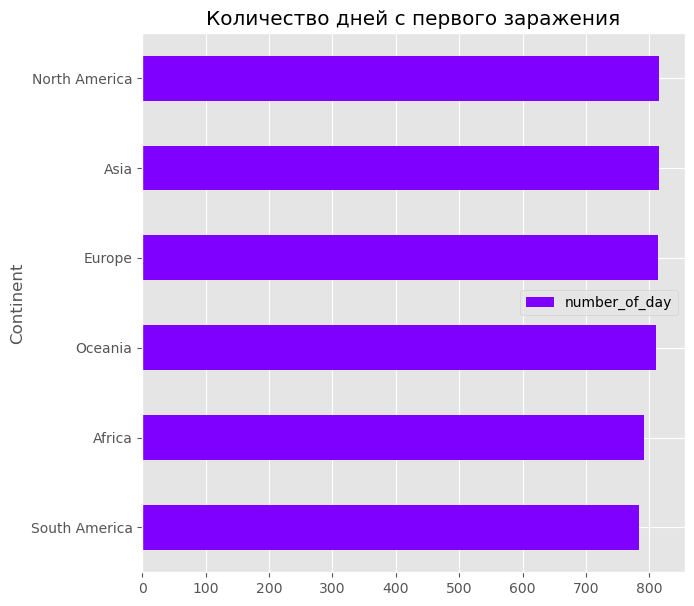

In [33]:
dfDays = df_spread.groupby(['Continent'], as_index=False)['number_of_day'].max()
dfDays = dfDays.sort_values(by = "number_of_day", ascending = True)
dfDays
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (7, 7)
dfDays.plot(kind ="barh", x = 'Continent', y = 'number_of_day', colormap='rainbow',title = 'Количество дней с первого заражения')

Видно, что в Северной Америке и Азии было больше заболевших, что логично, так как население этих континентов больше.

#### 1.5. (5 баллов)

Визуализируйте и оцените как развивалась ситуация в России по сравнению с остальными миром. Как вы будете осуществлять сравнение? Почему? Какие выводы можно сделать?

In [34]:
df_spread = df.groupby(['Date', 'Country'])[['Confirmed', 'Recovered', 'Deaths']].sum().reset_index()
first_day = df_spread[df_spread['Confirmed'] > 0].groupby('Country')['Date'].min()
df_spread = pd.merge(df_spread[df_spread['Confirmed'] > 0], first_day, on='Country')
df_spread['number_of_day'] = (df_spread['Date_x'] - df_spread['Date_y']).dt.days
df_spread['ill'] = df_spread['Confirmed'] - df_spread['Recovered'] - df_spread['Deaths']
df_spread = df_spread.rename(columns={'Date_y': 'first_day'})
df_spread

,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill
0,2020-01-22,China,548,28,17,2020-01-22,0,503
1,2020-01-23,China,643,30,18,2020-01-22,1,595
2,2020-01-24,China,920,36,26,2020-01-22,2,858
3,2020-01-25,China,1406,39,42,2020-01-22,3,1325
4,2020-01-26,China,2075,49,56,2020-01-22,4,1970
...,...,...,...,...,...,...,...,...
140540,2022-04-12,Tonga,8559,0,11,2021-10-29,165,8548
140541,2022-04-13,Tonga,8761,0,11,2021-10-29,166,8750
140542,2022-04-14,Tonga,8842,0,11,2021-10-29,167,8831
140543,2022-04-15,Tonga,8842,0,11,2021-10-29,168,8831


In [35]:
df2 = df_spread.groupby(['Country'])['ill'].max().reset_index()
df2 = df2.sort_values(by = "ill", ascending = False)
res = df2[0:20]['Country'].tolist()

In [36]:
df_new = pd.DataFrame()
for i in range(0,len(res)-1,2):
    df1 = df_spread[df_spread.Country == res[i]]
    df2 = df_spread[df_spread.Country == res[i+1]]
    curr = pd.concat([df1,df2])
    df_new = pd.concat([df_new,curr])
df_new

,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill
3264,2020-01-22,United States,1,0,0,2020-01-22,0,1
3265,2020-01-23,United States,1,0,0,2020-01-22,1,1
3266,2020-01-24,United States,2,0,0,2020-01-22,2,2
3267,2020-01-25,United States,2,0,0,2020-01-22,3,2
3268,2020-01-26,United States,5,0,0,2020-01-22,4,5
...,...,...,...,...,...,...,...,...
41400,2022-04-12,Mexico,5723862,0,323805,2020-02-28,774,5400057
41401,2022-04-13,Mexico,5724611,0,323848,2020-02-28,775,5400763
41402,2022-04-14,Mexico,5725075,0,323891,2020-02-28,776,5401184
41403,2022-04-15,Mexico,5725476,0,323903,2020-02-28,777,5401573


In [37]:
import plotly.express as px

fig = px.line(df_new, x="Date_x", y="ill", color='Country',title='Количество болеющих по странам')
fig.update_layout(
    autosize=False,
    width=800,
    height=500,)
fig.show()

Я оставила только двадцать стран с наибольшим количеством зараженных людей, чтобы проанализировать позицию России в мире. Можно заметить, что Россия схожа в скорости и распространении заболевания практически со всеми из этих 20 стран, за исключением США, Индии и Бразилии.

#### 1.6. (5 баллов)

Определите топ-10 стран, которые лидируют по имеющимся в датасете показателям. Постоянны ли эти лидеры? За какой временной промежуток было бы наиболее правильно брать лидеров, на ваш взгляд? Почему? Сравните насколько быстро развивается ситуация в этих странах. Определите корреляцию.

In [38]:
df2 = df_spread.groupby(['Country'])['ill'].max().reset_index()
df2 = df2.sort_values(by = "ill", ascending = False)
res = df2[0:10]['Country'].tolist()
res

['United States',
 'India',
 'Brazil',
 'France',
 'Germany',
 'United Kingdom',
 'Russian Federation',
 'Korea, Republic of',
 'Italy',
 'Turkey']

Это и есть список 10-ти лидирующих стран по показателям, построим отдельные графики по выздоровевшим, заболевшим и умершим:

In [39]:
df_new = pd.DataFrame()
for i in range(0,len(res)-1,2):
    df1 = df_spread[df_spread.Country == res[i]]
    df2 = df_spread[df_spread.Country == res[i+1]]
    curr = pd.concat([df1,df2])
    df_new = pd.concat([df_new,curr])
df_new

,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill
3264,2020-01-22,United States,1,0,0,2020-01-22,0,1
3265,2020-01-23,United States,1,0,0,2020-01-22,1,1
3266,2020-01-24,United States,2,0,0,2020-01-22,2,2
3267,2020-01-25,United States,2,0,0,2020-01-22,3,2
3268,2020-01-26,United States,5,0,0,2020-01-22,4,5
...,...,...,...,...,...,...,...,...
84692,2022-04-12,Turkey,14972502,0,98462,2020-03-11,762,14874040
84693,2022-04-13,Turkey,14978031,0,98493,2020-03-11,763,14879538
84694,2022-04-14,Turkey,14983158,0,98514,2020-03-11,764,14884644
84695,2022-04-15,Turkey,14987583,0,98532,2020-03-11,765,14889051


In [40]:
import plotly.express as px

fig = px.line(df_new, x="Date_x", y="Confirmed", color='Country',title='Количество заболевших по странам')
fig.update_layout(
    autosize=False,
    width=800,
    height=500,)
fig.show()

По количеству заболевших лидируют США, Бразилия и Индия

In [41]:
import plotly.express as px

fig = px.line(df_new, x="Date_x", y="Recovered", color='Country',title='Количество выздоровевших по странам')
fig.update_layout(
    autosize=False,
    width=800,
    height=500,)
fig.show()

Судя по графику, в какой-то момент страны перестали предоставлять данные о выздоровевших, но заметно, что в этой категории лидируют все те же три страны.

In [42]:
import plotly.express as px

fig = px.line(df_new, x="Date_x", y="Deaths", color='Country',title='Количество умерших по странам')
fig.update_layout(
    autosize=False,
    width=800,
    height=500,)
fig.show()

Заметна все та же тройка лидеров, что логично, потому что в этих странах большое население и была высокая летальность от коронавируса.

На моя взгляд, нужно оценивать лидеров именно в пик заражений и в отношении к населению, чтобы определить процент заразившихся. Определим корреляцию между лидерами:

In [43]:
for col in ['Confirmed', 'Recovered', 'Deaths']:
    print(f'Корреляция по признаку {col}')
    display(
        (df_new.groupby('Country')[[col, 'number_of_day']].agg(lambda x: list(x)).join(df_new.groupby('Country')[col].max().astype(np.int32),rsuffix='_max'))
        .T.apply(lambda x: pd.Series(x.loc[col])).corr())

Корреляция по признаку Confirmed


Country,Brazil,France,Germany,India,Italy,"Korea, Republic of",Russian Federation,Turkey,United Kingdom,United States
Country,,,,,,,,,,
Brazil,1.00,0.88,0.87,0.98,0.92,0.54,0.95,0.96,0.91,0.97
France,0.88,1.00,0.98,0.85,0.99,0.74,0.97,0.94,0.97,0.94
Germany,0.87,0.98,1.00,0.80,0.97,0.84,0.95,0.96,0.95,0.91
India,0.98,0.85,0.80,1.00,0.88,0.43,0.92,0.95,0.89,0.95
Italy,0.92,0.99,0.97,0.88,1.00,0.70,0.98,0.96,0.98,0.97
"Korea, Republic of",0.54,0.74,0.84,0.43,0.70,1.00,0.65,0.80,0.65,0.57
Russian Federation,0.95,0.97,0.95,0.92,0.98,0.65,1.00,0.99,0.99,0.99
Turkey,0.96,0.94,0.96,0.95,0.96,0.80,0.99,1.00,0.98,0.98
United Kingdom,0.91,0.97,0.95,0.89,0.98,0.65,0.99,0.98,1.00,0.97


Корреляция по признаку Recovered


Country,Brazil,France,Germany,India,Italy,"Korea, Republic of",Russian Federation,Turkey,United Kingdom,United States
Country,,,,,,,,,,
Brazil,1.00,0.81,0.79,0.74,0.81,0.71,0.84,0.89,0.80,0.08
France,0.81,1.00,0.96,0.93,0.94,0.96,0.95,0.73,0.94,0.01
Germany,0.79,0.96,1.00,0.94,0.98,0.95,0.96,0.73,0.97,-0.15
India,0.74,0.93,0.94,1.00,0.94,0.91,0.93,0.62,0.93,0.01
Italy,0.81,0.94,0.98,0.94,1.00,0.92,0.98,0.76,0.99,-0.15
"Korea, Republic of",0.71,0.96,0.95,0.91,0.92,1.00,0.90,0.63,0.91,-0.12
Russian Federation,0.84,0.95,0.96,0.93,0.98,0.90,1.00,0.77,0.99,-0.03
Turkey,0.89,0.73,0.73,0.62,0.76,0.63,0.77,1.00,0.75,-0.01
United Kingdom,0.80,0.94,0.97,0.93,0.99,0.91,0.99,0.75,1.00,-0.12


Корреляция по признаку Deaths


Country,Brazil,France,Germany,India,Italy,"Korea, Republic of",Russian Federation,Turkey,United Kingdom,United States
Country,,,,,,,,,,
Brazil,1.00,0.98,0.98,0.98,0.98,0.80,0.92,0.97,0.96,0.98
France,0.98,1.00,0.99,0.95,1.00,0.68,0.91,0.95,0.99,0.99
Germany,0.98,0.99,1.00,0.95,0.99,0.73,0.93,0.96,0.98,0.99
India,0.98,0.95,0.95,1.00,0.94,0.72,0.94,0.97,0.92,0.96
Italy,0.98,1.00,0.99,0.94,1.00,0.70,0.89,0.95,0.99,0.98
"Korea, Republic of",0.80,0.68,0.73,0.72,0.70,1.00,0.85,0.91,0.69,0.75
Russian Federation,0.92,0.91,0.93,0.94,0.89,0.85,1.00,0.99,0.88,0.95
Turkey,0.97,0.95,0.96,0.97,0.95,0.91,0.99,1.00,0.93,0.98
United Kingdom,0.96,0.99,0.98,0.92,0.99,0.69,0.88,0.93,1.00,0.98


Высокая корреляция показывает, что среди лидеров и правда есть страны, в которых показатели развивались одинаково, выделяется только Корея.

#### 1.7. (5 баллов)

Для первых 5 стран из топ-10 из прошлого задания и России (суммарно 5 или 6 стран, в зависимости от того, входит ли Россия в топ) постройте сравнительные графики. Изучите как изменялись значения отношений 
- погибших/выздоровивших 
- погибших/заболевших 
- заболевших/общее число жителей
- еще один ваш вариант (что будет осмысленно здесь взять?)

Какие выводы можно сделать из подобного сравнения?

In [44]:
df2 = df_spread.groupby(['Country'])['ill'].max().reset_index()
df2 = df2.sort_values(by = "ill", ascending = False)
res = df2[0:5]['Country'].tolist()
res

['United States', 'India', 'Brazil', 'France', 'Germany']

Россия не входит в топ-5, поэтому добавим ее отдельно. Нужно найти данные по населению для этих 6 стран.

In [45]:
res.append('Russian Federation')
res

['United States', 'India', 'Brazil', 'France', 'Germany', 'Russian Federation']

In [46]:
population = pd.read_csv('population_by_country_2020.csv')
population['Country'] = population['Country (or dependency)'].fillna('')
population.drop('Country (or dependency)', inplace=True, axis=1)
population

,Population (2020),Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share,Country
0,1440297825,0.39 %,5540090,153,9388211,-348399.00,1.7,38,61 %,18.47 %,China
1,1382345085,0.99 %,13586631,464,2973190,-532687.00,2.2,28,35 %,17.70 %,India
2,331341050,0.59 %,1937734,36,9147420,954806.00,1.8,38,83 %,4.25 %,United States
3,274021604,1.07 %,2898047,151,1811570,-98955.00,2.3,30,56 %,3.51 %,Indonesia
4,221612785,2.00 %,4327022,287,770880,-233379.00,3.6,23,35 %,2.83 %,Pakistan
...,...,...,...,...,...,...,...,...,...,...,...
230,4993,0.06 %,3,50,100,NaN,N.A.,N.A.,10 %,0.00 %,Montserrat
231,3497,3.05 %,103,0,12170,NaN,N.A.,N.A.,66 %,0.00 %,Falkland Islands
232,1628,0.68 %,11,6,260,NaN,N.A.,N.A.,46 %,0.00 %,Niue
233,1360,1.27 %,17,136,10,NaN,N.A.,N.A.,0 %,0.00 %,Tokelau


In [47]:
df_new = pd.DataFrame()
for i in range(0,len(res)-1,2):
    df1 = df_spread[df_spread.Country == res[i]]
    df2 = df_spread[df_spread.Country == res[i+1]]
    curr = pd.concat([df1,df2])
    df_new = pd.concat([df_new,curr])
df_new

,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill
3264,2020-01-22,United States,1,0,0,2020-01-22,0,1
3265,2020-01-23,United States,1,0,0,2020-01-22,1,1
3266,2020-01-24,United States,2,0,0,2020-01-22,2,2
3267,2020-01-25,United States,2,0,0,2020-01-22,3,2
3268,2020-01-26,United States,5,0,0,2020-01-22,4,5
...,...,...,...,...,...,...,...,...
17053,2022-04-12,Russian Federation,17756183,0,364779,2020-01-31,802,17391404
17054,2022-04-13,Russian Federation,17767760,0,365038,2020-01-31,803,17402722
17055,2022-04-14,Russian Federation,17778928,0,365285,2020-01-31,804,17413643
17056,2022-04-15,Russian Federation,17790211,0,365540,2020-01-31,805,17424671


In [48]:
df_c = pd.merge(df_new, population, on='Country', how='inner')
df_c

,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Population (2020),Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,2020-01-22,United States,1,0,0,2020-01-22,0,1,331341050,0.59 %,1937734,36,9147420,954806.00,1.8,38,83 %,4.25 %
1,2020-01-23,United States,1,0,0,2020-01-22,1,1,331341050,0.59 %,1937734,36,9147420,954806.00,1.8,38,83 %,4.25 %
2,2020-01-24,United States,2,0,0,2020-01-22,2,2,331341050,0.59 %,1937734,36,9147420,954806.00,1.8,38,83 %,4.25 %
3,2020-01-25,United States,2,0,0,2020-01-22,3,2,331341050,0.59 %,1937734,36,9147420,954806.00,1.8,38,83 %,4.25 %
4,2020-01-26,United States,5,0,0,2020-01-22,4,5,331341050,0.59 %,1937734,36,9147420,954806.00,1.8,38,83 %,4.25 %
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4025,2022-04-12,Germany,23017079,0,132378,2020-01-27,806,22884701,83830972,0.32 %,266897,240,348560,543822.00,1.6,46,76 %,1.07 %
4026,2022-04-13,Germany,23182447,0,132688,2020-01-27,807,23049759,83830972,0.32 %,266897,240,348560,543822.00,1.6,46,76 %,1.07 %
4027,2022-04-14,Germany,23339311,0,132900,2020-01-27,808,23206411,83830972,0.32 %,266897,240,348560,543822.00,1.6,46,76 %,1.07 %
4028,2022-04-15,Germany,23376879,0,132929,2020-01-27,809,23243950,83830972,0.32 %,266897,240,348560,543822.00,1.6,46,76 %,1.07 %


Для анализа можно было бы еще добавить отношение выздоровевших к заболевшим. Добавим четыре столбца в объединенный датафрейм:

In [49]:
df_c['Deaths/Recovered'] = df_c['Deaths'] / (df_c['Recovered'] + 1) 
df_c['Deaths/Confirmed'] = df_c['Deaths'] / (df_c['Confirmed'] + 1)
df_c['Confirmed/Population (2020)'] = df_c['Confirmed'] / df_c['Population (2020)']
df_c['Recovered/Confirmed'] = df_c['Recovered'] / (df_c['Confirmed'] + 1) 
df_c.head()

,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Population (2020),Yearly Change,...,Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share,Deaths/Recovered,Deaths/Confirmed,Confirmed/Population (2020),Recovered/Confirmed
0,2020-01-22,United States,1,0,0,2020-01-22,0,1,331341050,0.59 %,...,9147420,954806.00,1.8,38,83 %,4.25 %,0.00,0.00,0.00,0.00
1,2020-01-23,United States,1,0,0,2020-01-22,1,1,331341050,0.59 %,...,9147420,954806.00,1.8,38,83 %,4.25 %,0.00,0.00,0.00,0.00
2,2020-01-24,United States,2,0,0,2020-01-22,2,2,331341050,0.59 %,...,9147420,954806.00,1.8,38,83 %,4.25 %,0.00,0.00,0.00,0.00
3,2020-01-25,United States,2,0,0,2020-01-22,3,2,331341050,0.59 %,...,9147420,954806.00,1.8,38,83 %,4.25 %,0.00,0.00,0.00,0.00
4,2020-01-26,United States,5,0,0,2020-01-22,4,5,331341050,0.59 %,...,9147420,954806.00,1.8,38,83 %,4.25 %,0.00,0.00,0.00,0.00


In [50]:
fig = px.line(df_c, x="Date_x", y="Deaths/Recovered", color='Country',title='Отношение умерших к выздоровевшим по странам')
fig.update_layout(
    autosize=False,
    width=800,
    height=500,)
fig.show()

In [51]:
fig = px.line(df_c, x="Date_x", y="Deaths/Confirmed", color='Country',title='Отношение умерших к заболевшим по странам')
fig.update_layout(
    autosize=False,
    width=800,
    height=500,)
fig.show()

In [52]:
fig = px.line(df_c, x="Date_x", y="Recovered/Confirmed", color='Country',title='Отношение выздоровевших к заболевшим по странам')
fig.update_layout(
    autosize=False,
    width=800,
    height=500,)
fig.show()

In [53]:
fig = px.line(df_c, x="Date_x", y="Confirmed/Population (2020)", color='Country',title='Отношение заболевших к населению по странам')
fig.update_layout(
    autosize=False,
    width=800,
    height=500,)
fig.show()

Можно заметить, что хоть эти страны и лидеры по показателям, относительно их населения, процент заболевших достаточно невысокий. Также можно заметить, что сначала очень высокой была смертность, но потом, с увеличением заболевших, показатель стабилизировался. По увеличивающемуся показателю отношения умерших к выздоровевшим судить нельзя, так как в определенный момент страны перестали предоставлять информацию о Recovered.

#### 1.8. (5 баллов и 15 бонусных баллов)

Изучаемый вами датасет отражает мировую статистику распространения болезни. Однако эти данные не дают нам возможности сделать предположения о возможных факторах, которые влияют на скорость распространения, летальность, заразность и тд. Поэтому в наш датасет можно добавить новые признаки из других наборов данных, которые могут не только помочь при прогнозировании временного ряда, но и определить наиболее значимые факторы.

- Добавьте новый признак "количество дней со дня первого случая заражения".
- Добавьте еще не менее 5 новых признаков в датасет, которые могут быть значимым фактором распространения вируса. Сохраните полученный датасет. Вы можете его использовать в третьей части домашнего задания (за это вы сможете получить там дополнительные бонусные баллы).
- Исследуйте, как добавленные признаки соотносятся с трендами распространения короновируса в некоторых странах. Сделайте выводы.

*Подсказка: некоторые примеры признаков (список далеко не исчерпывающий и лучше хотя бы несколько придумать своих): количество дней с начала карантина; конинент; плотность населения; количество употребляемого алкоголя; распространенность летучих мышей; количество крокодилов на душу населения; количество туристов в год; уровень безработицы; температура; количество игроков в Plague Inc.; средний возраст или продолжительность жизни; и так далее. Вы можете использовать любой найденный датасет. Главное, чтобы у Вас получилось скомбинировать данные.*

  Примеры датасетов для вас:
  1. [500 Cities: Local Data for Better Health (2019)](https://www.kaggle.com/jaimeblasco/500-cities-local-data-for-better-health-2019)
  2. [Daily global surface summary from over 9000 weather stations from 1929 to now](https://www.kaggle.com/noaa/gsod)
  3. [Population by Country - 2020](https://www.kaggle.com/tanuprabhu/population-by-country-2020)



In [54]:
df_spread
df_spread['Deaths/Confirmed'] = df_spread['Deaths'] / (df_spread['Confirmed'] + 1)

In [55]:
fig = px.line(df_spread, x="number_of_day", y='Deaths/Confirmed', color='Country',title='Отношение умерших к заболевшим по дням')
fig.update_layout(
    autosize=False,
    width=800,
    height=500,)
fig.show()

В графике по дням с начала коронавируса уже нет явных лидеров, заметно, что в первые месяцы заболевания смертность была высокая, что логично, так как люди не знали, как лечить это заболевание.

In [56]:
df1 = pd.DataFrame(columns=['TotalConfirmed', 'TotalRecovered', 'TotalDeaths'])
df1.TotalConfirmed = df_spread.groupby(df['Country']).Confirmed.max()
df1.TotalRecovered = df_spread.groupby(df['Country']).Recovered.max()
df1.TotalDeaths = df_spread.groupby(df['Country']).Deaths.max()
df1

,TotalConfirmed,TotalRecovered,TotalDeaths
Country,,,
Afghanistan,1760211,99228,13748
Albania,7332261,852451,28998
Algeria,16305752,180719,21092
Andorra,4029959,26873,26882
Angola,80625120,6298082,988609
...,...,...,...
Liberia,12437,20,139
Libya,6314,3,7
Liechtenstein,4793,3,13


In [57]:
food = pd.read_csv('Protein_Supply_Quantity_Data.csv')
food = food[['Country','Meat','Alcoholic Beverages', 'Obesity']]
food

,Country,Meat,Alcoholic Beverages,Obesity
0,Afghanistan,3.13,0.00,4.50
1,Albania,7.66,0.18,22.30
2,Algeria,3.51,0.03,26.60
3,Angola,7.62,0.63,6.80
4,Antigua and Barbuda,16.07,0.15,19.10
...,...,...,...,...
165,Venezuela (Bolivarian Republic of),11.83,0.20,25.20
166,Vietnam,11.04,0.16,2.10
167,Yemen,5.95,0.00,14.10
168,Zambia,4.32,0.48,6.50


In [58]:
df_new = pd.merge(df1,food,on='Country', how = 'inner')
df_new

,Country,TotalConfirmed,TotalRecovered,TotalDeaths,Meat,Alcoholic Beverages,Obesity
0,Afghanistan,1760211,99228,13748,3.13,0.00,4.50
1,Albania,7332261,852451,28998,7.66,0.18,22.30
2,Algeria,16305752,180719,21092,3.51,0.03,26.60
3,Angola,80625120,6298082,988609,7.62,0.63,6.80
4,Antigua and Barbuda,1157251,63357,1313,16.07,0.15,19.10
...,...,...,...,...,...,...,...
81,Lebanon,17786,14867,125,6.96,0.05,31.30
82,Lesotho,32968,6664,697,5.92,0.27,13.50
83,Liberia,12437,20,139,8.32,0.08,8.60
84,Lithuania,8922,0,11,11.25,0.53,28.40


Из этого датасета я возьму три показателя: потребление мяса, так как белок поддерживает иммунитет, потребление алкоголя и процент людей, страдающих ожирением, так как есть исследование о прямой связи коронавируса и ожирения.

In [59]:
sanity = pd.read_csv('basicHandWashing.csv')
sanity = sanity.groupby('Location')['First Tooltip'].sum().reset_index()
sanity = pd.DataFrame(sanity)
sanity['Country'] = sanity['Location']
sanity.drop('Location',inplace=True,axis=1)
sanity

,First Tooltip,Country
0,1688.71,Afghanistan
1,2198.84,Algeria
2,440.87,Angola
3,4696.76,Armenia
4,749.16,Azerbaijan
...,...,...
92,817.05,Vanuatu
93,3382.29,Viet Nam
94,1414.18,Yemen
95,354.51,Zambia


Этот датасет показывает процент пользования санитарными средствами по регионам, я просто сложила проценты для упрощения анализа.

In [60]:
df_l = pd.merge(df_new,sanity,on='Country', how = 'inner')
df_l['Deaths/Confirmed'] = df_l['TotalDeaths']/df_l['TotalConfirmed']
df_l['by-alco']= df_l['Deaths/Confirmed']/(df_l['Alcoholic Beverages']+0.01)
df_l['by-protein'] =df_l['Deaths/Confirmed']/ (df_l['Meat']+0.01)
df_l['by-obesity'] =df_l['Deaths/Confirmed']/(df_l['Obesity']+0.01)
df_l['by-washing'] = df_l['Deaths/Confirmed']/df_l['First Tooltip']
df_l

,Country,TotalConfirmed,TotalRecovered,TotalDeaths,Meat,Alcoholic Beverages,Obesity,First Tooltip,Deaths/Confirmed,by-alco,by-protein,by-obesity,by-washing
0,Afghanistan,1760211,99228,13748,3.13,0.00,4.50,1688.71,0.01,0.78,0.00,0.00,0.00
1,Algeria,16305752,180719,21092,3.51,0.03,26.60,2198.84,0.00,0.03,0.00,0.00,0.00
2,Angola,80625120,6298082,988609,7.62,0.63,6.80,440.87,0.01,0.02,0.00,0.00,0.00
3,Armenia,27874269,415111,145159,8.52,0.04,20.90,4696.76,0.01,0.10,0.00,0.00,0.00
4,Azerbaijan,3682847,1528422,59964,6.86,0.35,19.90,749.16,0.02,0.05,0.00,0.00,0.00
5,Bangladesh,21916961,100875,172014,1.28,0.00,3.40,1435.75,0.01,0.78,0.01,0.00,0.00
6,Barbados,11627487,150376,103104,13.99,0.13,24.80,796.23,0.01,0.06,0.00,0.00,0.00
7,Belize,511977,232179,24522,10.75,0.20,22.40,3204.52,0.05,0.23,0.00,0.00,0.00
8,Benin,7205064,3444798,140800,5.69,0.74,8.20,342.09,0.02,0.03,0.00,0.00,0.00
9,Bosnia and Herzegovina,3528626,1575377,57231,6.71,0.53,19.40,2624.23,0.02,0.03,0.00,0.00,0.00


Так как эти показатели статические, нет смысла анализировать их изменение по времени, можно просто отследить зависимость летальности от данных показателей.

Можно заметить, что достаточно коррелирует потребление алкоголя и летальность,процент людей, страдающих ожирением, тоже влияет в некоторых случаях.

#### 1.9. (5 баллов)

Какие закономерности и тенденции бросились вам в глаза в ходе проделанного в разделе 1 анализа? Что оказалось неожиданным, а что, наоборот, ожидаемым? Почему? Напишите итоговые выводы по проделанному вами первичному анализу данных в рамках данного раздела.

Во всех странах были вспышки заболеваемости в первые дни и высокая летальность, потом эти показатели нормализовались. Среди лиедров по заболеваемости - США, Бразилия и Индия. Но оценивать правильнее именно в отношении к населению, поэтому правильными лидерами будут страны Африки, что видно в распределении по континентам. Неожиданнным показалось то, что Китая нет даже в 10 лидеров по показателям. То, что США лидирует по всем показателям, не оказалось неожиданностью, так как уже есть много объяснений тому, что американцы подвержены таким заболеваниям.

## Раздел 2. Статистический анализ и подготовка данных (28 баллов)


#### 2.1. (5 баллов)

В рамках задачи исследования и прогнозирования тенденций развития пандемии коронавируса, не очень интересно предсказывать количество заболевших/умерших к моменту окончания исследуемого периода данного датасета, поскольку все изменения значений будут близки к нулю - пандемия фактически уже окончилась. Какой в таком случае конец "известного" периода имело бы смысл взять? 

Также, с другой стороны: все ли данные от начала пандемии нам необходимы и полезны для анализа и прогнозирования? Почему? Обрежьте наш датасет с конца и (если необходимо) с начала, выделив тем самым интересующий нас рабочий период для анализа. Обязательно аргументируйте, почему вы решили взять период именно таким. Обрезку, на всякий случай, осуществляйте в копии датасета и сохраните исходный датасет на случай необходимости дополнительного анализа/анализа на других временных интервалах.

В какой-то момент в датасете все значения Recovered становятся равны нулы, поэтому анализировать эти данные нет смысла, так как не будут видны зависимости между заболевшими и выздоровевшими. Анализировать самое начало коронавируса тоже нет смысла, так как в начале везде были вспышки заболеваний, поэтому это будет явный неоднородный ряд, который тяжело прогнозировать.

In [61]:
df_cut = df_spread.copy()
df_cut = df_cut.loc[df_cut["Date_x"] <= "2021-06-01"]
df_cut = df_cut.loc[df_cut["number_of_day"] >= 70]
df_cut

,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed
70,2020-04-01,China,84002,76405,3316,2020-01-22,70,4281,0.04
71,2020-04-02,China,84129,76565,3322,2020-01-22,71,4242,0.04
72,2020-04-03,China,84265,76760,3326,2020-01-22,72,4179,0.04
73,2020-04-04,China,84363,76946,3330,2020-01-22,73,4087,0.04
74,2020-04-05,China,84467,77207,3333,2020-01-22,74,3927,0.04
...,...,...,...,...,...,...,...,...,...
139479,2021-05-28,Samoa,3,3,0,2020-11-18,191,0,0.00
139480,2021-05-29,Samoa,3,3,0,2020-11-18,192,0,0.00
139481,2021-05-30,Samoa,3,3,0,2020-11-18,193,0,0.00
139482,2021-05-31,Samoa,3,3,0,2020-11-18,194,0,0.00


По графику анализа количества выздоровевших было видно, что где-то в июле 2021 многие страны перестали предоставлять данные, поэтому я обрезала датасет до июня. По графику зависимости от первого дня заболеваний видно, что до 70 дня есть неконтролируемые колебания, поэтому я выбрала данные с 70 дня.

#### 2.2. (10 баллов)

Выделите временной ряд по одному из имеющихся у нас целевых признаков на ваш выбор. Для выделенного временного ряда проведите простой статистический анализ:

- Рассчитайте несколько первых лагов для временного ряда, выведите их на графике.
- Представьте временной ряд в виде последовательности разниц между значениями и визуализируйте её. Представьте его также в виде последовательности разниц разниц. Визуализируйте и это.
- Перейдите от временного ряда к логарифму временного ряда. Визуализируйте полученный ряд. Что можно сказать об изменениях?
- Осуществите декомпозицию временного ряда (тренд, сезонность, резидуалс). Постройте график тренда отдельно и график тренда на тех же осях, что и исходный временной ряд. Повторите проделанные действия для логарифма временного ряда. Имеется ли разница?
- Что вы можете сказать о стационарности временного ряда? Почему? Осуществите проверку на стационарность (желательно, с использованием методов математической статистики). Что можно сказать о стационарности последовательности разниц и последовательности разниц разниц? Также осуществите проверку на стационарность для этих рядов.

Какие выводы вы можете сделать из проделанного анализа?

In [62]:
df_newcut = df_cut[df_cut['Country'] == 'United States'].reset_index()
df_newcut

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed
0,3334,2020-04-01,United States,223254,8474,6635,2020-01-22,70,208145,0.03
1,3335,2020-04-02,United States,255530,9001,8142,2020-01-22,71,238387,0.03
2,3336,2020-04-03,United States,287931,9707,9562,2020-01-22,72,268662,0.03
3,3337,2020-04-04,United States,319776,14652,11165,2020-01-22,73,293959,0.03
4,3338,2020-04-05,United States,349016,17448,12781,2020-01-22,74,318787,0.04
...,...,...,...,...,...,...,...,...,...,...
422,3756,2021-05-28,United States,33349400,0,589535,2020-01-22,492,32759865,0.02
423,3757,2021-05-29,United States,33362711,0,589878,2020-01-22,493,32772833,0.02
424,3758,2021-05-30,United States,33370065,0,590027,2020-01-22,494,32780038,0.02
425,3759,2021-05-31,United States,33376340,0,590199,2020-01-22,495,32786141,0.02


Будем анализировать США, так как по этой стране больше всего данных.

In [63]:
#рассчитаем лаги
df_newcut['Confirmed_lag1'] = df_newcut.Confirmed.shift()
df_newcut["lag1"] = df_newcut.Confirmed - df_newcut.Confirmed_lag1
df_newcut['Confirmed_lag2'] = df_newcut.Confirmed.shift(periods=2)
df_newcut["lag2"] = df_newcut.Confirmed - df_newcut.Confirmed_lag2
df_newcut['Confirmed_lag3'] = df_newcut.Confirmed.shift(periods=3)
df_newcut["lag3"] = df_newcut.Confirmed - df_newcut.Confirmed_lag3
df_newcut['Confirmed_lag4'] = df_newcut.Confirmed.shift(periods=4)
df_newcut["lag4"] = df_newcut.Confirmed - df_newcut.Confirmed_lag4
df_newcut.head()

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,Confirmed_lag1,lag1,Confirmed_lag2,lag2,Confirmed_lag3,lag3,Confirmed_lag4,lag4
0,3334,2020-04-01,United States,223254,8474,6635,2020-01-22,70,208145,0.03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3335,2020-04-02,United States,255530,9001,8142,2020-01-22,71,238387,0.03,223254.00,32276.00,NaN,NaN,NaN,NaN,NaN,NaN
2,3336,2020-04-03,United States,287931,9707,9562,2020-01-22,72,268662,0.03,255530.00,32401.00,223254.00,64677.00,NaN,NaN,NaN,NaN
3,3337,2020-04-04,United States,319776,14652,11165,2020-01-22,73,293959,0.03,287931.00,31845.00,255530.00,64246.00,223254.00,96522.00,NaN,NaN
4,3338,2020-04-05,United States,349016,17448,12781,2020-01-22,74,318787,0.04,319776.00,29240.00,287931.00,61085.00,255530.00,93486.00,223254.00,125762.00


<AxesSubplot: xlabel='number_of_day'>

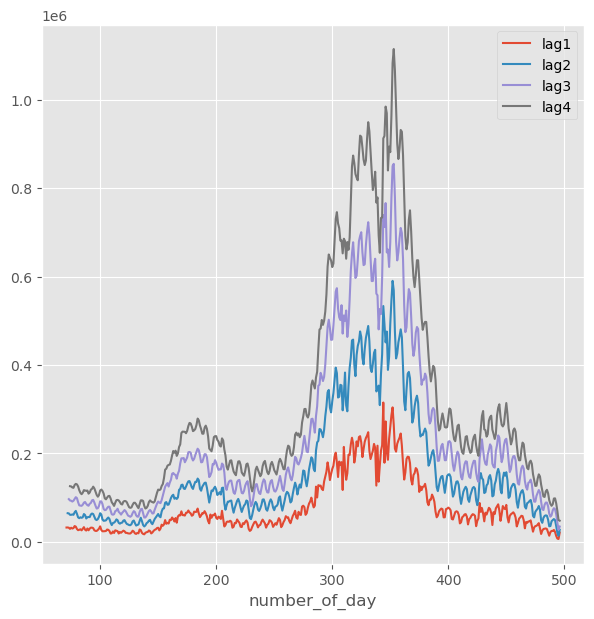

In [64]:
df_newcut.plot(kind="line", x="number_of_day", y = ["lag1", "lag2", "lag3", "lag4"])

Разницей в значениях и будет lag1, а разницей разниц - lag от lag1.

In [65]:
df_newcut['lag1_shift'] = df_newcut.lag1.shift()
df_newcut["lag11"] = df_newcut.lag1 - df_newcut.lag1_shift
df_newcut

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,Confirmed_lag1,lag1,Confirmed_lag2,lag2,Confirmed_lag3,lag3,Confirmed_lag4,lag4,lag1_shift,lag11
0,3334,2020-04-01,United States,223254,8474,6635,2020-01-22,70,208145,0.03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3335,2020-04-02,United States,255530,9001,8142,2020-01-22,71,238387,0.03,223254.00,32276.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3336,2020-04-03,United States,287931,9707,9562,2020-01-22,72,268662,0.03,255530.00,32401.00,223254.00,64677.00,NaN,NaN,NaN,NaN,32276.00,125.00
3,3337,2020-04-04,United States,319776,14652,11165,2020-01-22,73,293959,0.03,287931.00,31845.00,255530.00,64246.00,223254.00,96522.00,NaN,NaN,32401.00,-556.00
4,3338,2020-04-05,United States,349016,17448,12781,2020-01-22,74,318787,0.04,319776.00,29240.00,287931.00,61085.00,255530.00,93486.00,223254.00,125762.00,31845.00,-2605.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
422,3756,2021-05-28,United States,33349400,0,589535,2020-01-22,492,32759865,0.02,33327156.00,22244.00,33300313.00,49087.00,33275718.00,73682.00,33251126.00,98274.00,26843.00,-4599.00
423,3757,2021-05-29,United States,33362711,0,589878,2020-01-22,493,32772833,0.02,33349400.00,13311.00,33327156.00,35555.00,33300313.00,62398.00,33275718.00,86993.00,22244.00,-8933.00
424,3758,2021-05-30,United States,33370065,0,590027,2020-01-22,494,32780038,0.02,33362711.00,7354.00,33349400.00,20665.00,33327156.00,42909.00,33300313.00,69752.00,13311.00,-5957.00
425,3759,2021-05-31,United States,33376340,0,590199,2020-01-22,495,32786141,0.02,33370065.00,6275.00,33362711.00,13629.00,33349400.00,26940.00,33327156.00,49184.00,7354.00,-1079.00


<AxesSubplot: xlabel='number_of_day'>

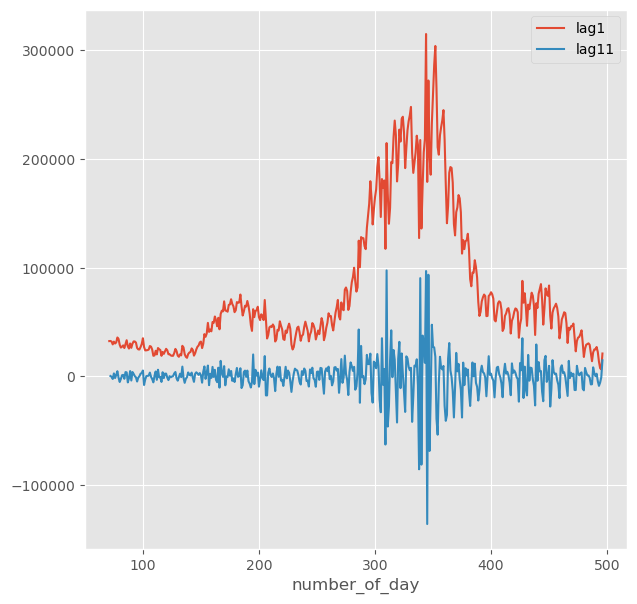

In [66]:
df_newcut.plot(kind="line", x="number_of_day", y = ["lag1", "lag11"])

Заметно, что разница разниц уже больше похожа на стационарный ряд. Теперь посмотрим на логарифмированный ряд:

In [67]:
df_newcut['Confirmed_log'] = np.log(df_newcut.Confirmed)
df_newcut.head()

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,...,lag1,Confirmed_lag2,lag2,Confirmed_lag3,lag3,Confirmed_lag4,lag4,lag1_shift,lag11,Confirmed_log
0,3334,2020-04-01,United States,223254,8474,6635,2020-01-22,70,208145,0.03,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.32
1,3335,2020-04-02,United States,255530,9001,8142,2020-01-22,71,238387,0.03,...,32276.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.45
2,3336,2020-04-03,United States,287931,9707,9562,2020-01-22,72,268662,0.03,...,32401.00,223254.00,64677.00,NaN,NaN,NaN,NaN,32276.00,125.00,12.57
3,3337,2020-04-04,United States,319776,14652,11165,2020-01-22,73,293959,0.03,...,31845.00,255530.00,64246.00,223254.00,96522.00,NaN,NaN,32401.00,-556.00,12.68
4,3338,2020-04-05,United States,349016,17448,12781,2020-01-22,74,318787,0.04,...,29240.00,287931.00,61085.00,255530.00,93486.00,223254.00,125762.00,31845.00,-2605.00,12.76


Логарифмированный ряд будет иметь меньшие выбросы, так как все значения будут ближе к среднему.

<AxesSubplot: xlabel='number_of_day'>

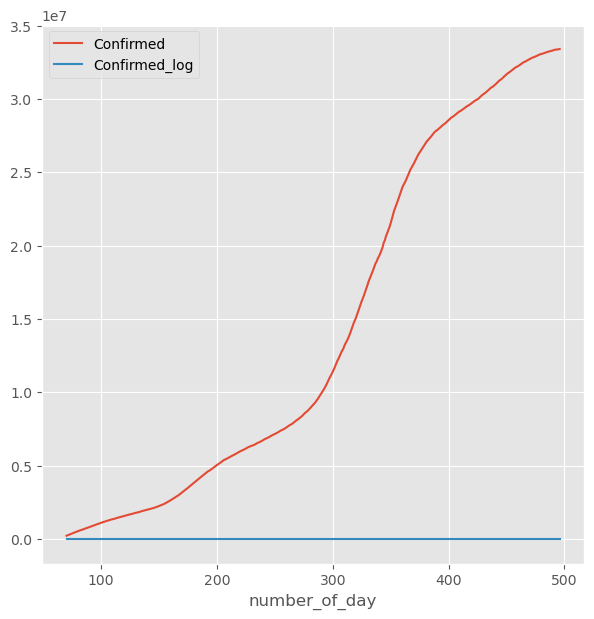

In [68]:
df_newcut.plot(kind="line", x="number_of_day", y = ["Confirmed", "Confirmed_log"])

In [69]:
df_newcut['Confirmed_log_lag'] = df_newcut.Confirmed_log.shift()
df_newcut["lag1_log"] = df_newcut.Confirmed_log - df_newcut.Confirmed_log_lag
df_newcut

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,...,lag2,Confirmed_lag3,lag3,Confirmed_lag4,lag4,lag1_shift,lag11,Confirmed_log,Confirmed_log_lag,lag1_log
0,3334,2020-04-01,United States,223254,8474,6635,2020-01-22,70,208145,0.03,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.32,NaN,NaN
1,3335,2020-04-02,United States,255530,9001,8142,2020-01-22,71,238387,0.03,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.45,12.32,0.14
2,3336,2020-04-03,United States,287931,9707,9562,2020-01-22,72,268662,0.03,...,64677.00,NaN,NaN,NaN,NaN,32276.00,125.00,12.57,12.45,0.12
3,3337,2020-04-04,United States,319776,14652,11165,2020-01-22,73,293959,0.03,...,64246.00,223254.00,96522.00,NaN,NaN,32401.00,-556.00,12.68,12.57,0.10
4,3338,2020-04-05,United States,349016,17448,12781,2020-01-22,74,318787,0.04,...,61085.00,255530.00,93486.00,223254.00,125762.00,31845.00,-2605.00,12.76,12.68,0.09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
422,3756,2021-05-28,United States,33349400,0,589535,2020-01-22,492,32759865,0.02,...,49087.00,33275718.00,73682.00,33251126.00,98274.00,26843.00,-4599.00,17.32,17.32,0.00
423,3757,2021-05-29,United States,33362711,0,589878,2020-01-22,493,32772833,0.02,...,35555.00,33300313.00,62398.00,33275718.00,86993.00,22244.00,-8933.00,17.32,17.32,0.00
424,3758,2021-05-30,United States,33370065,0,590027,2020-01-22,494,32780038,0.02,...,20665.00,33327156.00,42909.00,33300313.00,69752.00,13311.00,-5957.00,17.32,17.32,0.00
425,3759,2021-05-31,United States,33376340,0,590199,2020-01-22,495,32786141,0.02,...,13629.00,33349400.00,26940.00,33327156.00,49184.00,7354.00,-1079.00,17.32,17.32,0.00


<AxesSubplot: xlabel='number_of_day'>

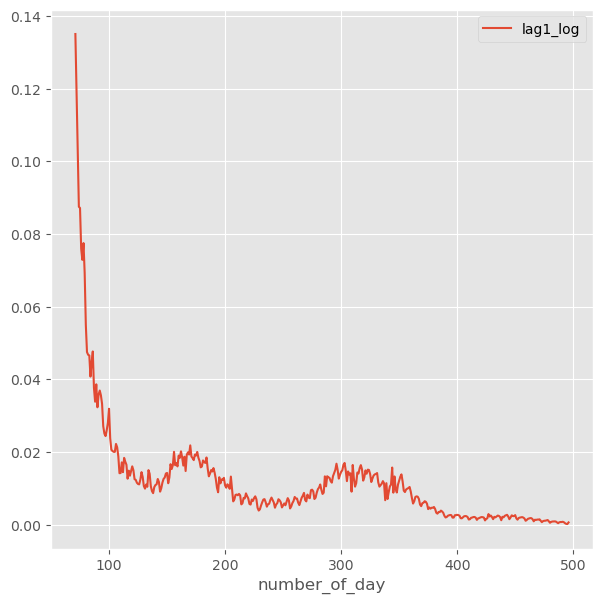

In [70]:
df_newcut.plot(kind="line", x="number_of_day", y = 'lag1_log')

Логарифмированный ряд и правда имеет меньше выбросов, но только после 100 дня.

In [71]:
from statsmodels.tsa.seasonal import seasonal_decompose
df_newcut = df_newcut.set_index(df_newcut.Date_x)
decomposition = seasonal_decompose(df_newcut.Confirmed, model = "additive")


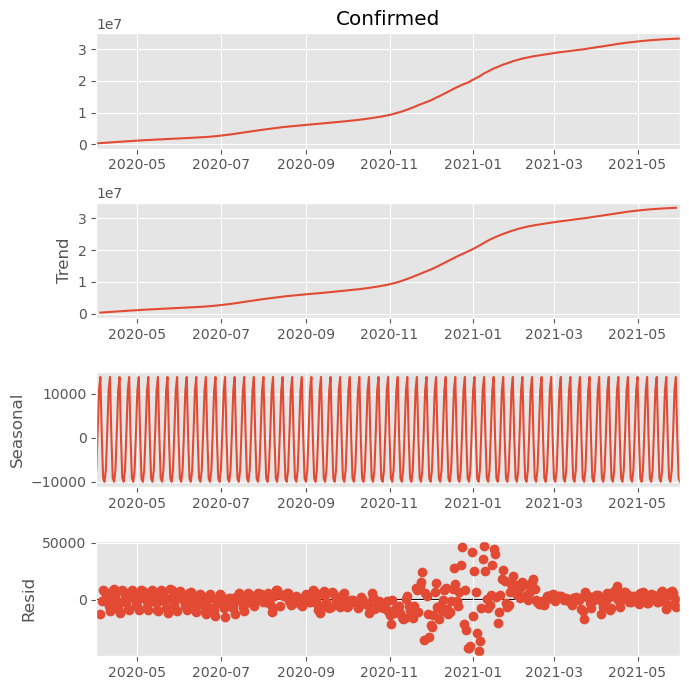

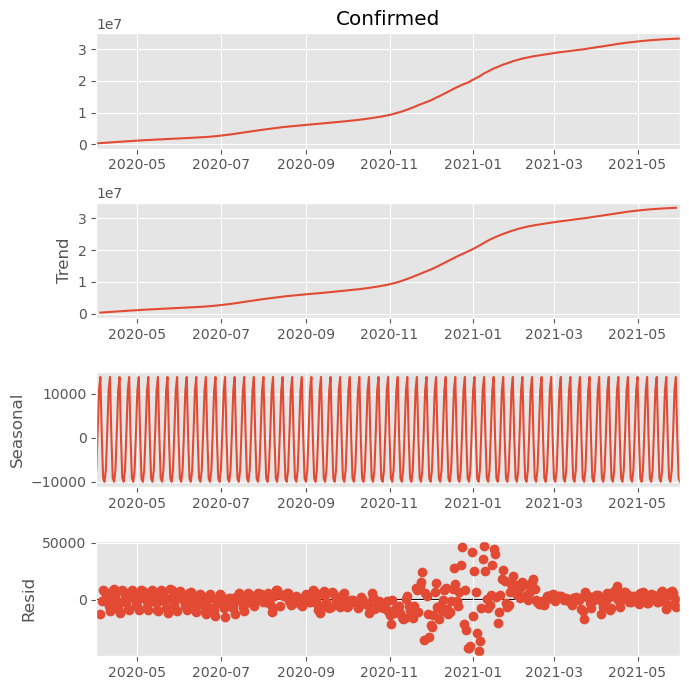

In [72]:
decomposition.plot()

<AxesSubplot: xlabel='number_of_day'>

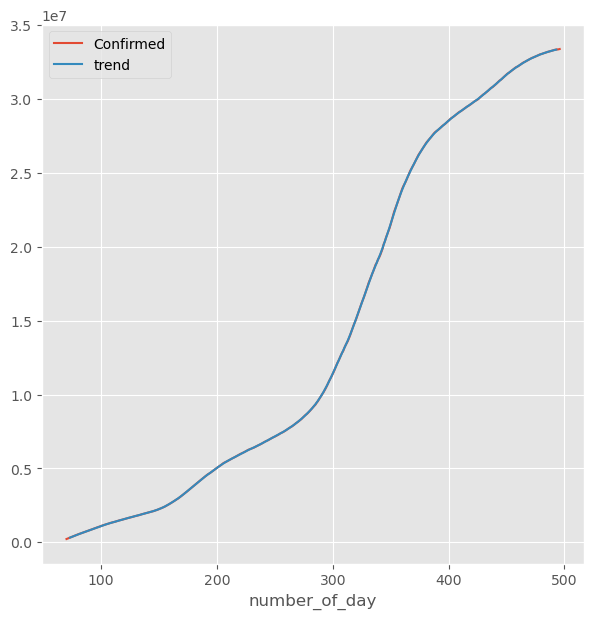

In [73]:
trend = decomposition.trend
df_newcut['trend'] = trend
df_newcut.plot(kind="line", x="number_of_day", y = ["Confirmed", 'trend'])

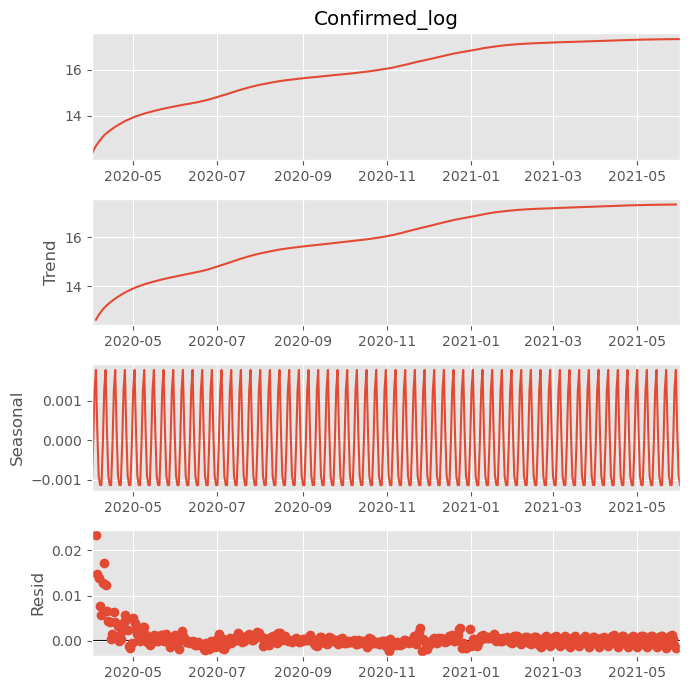

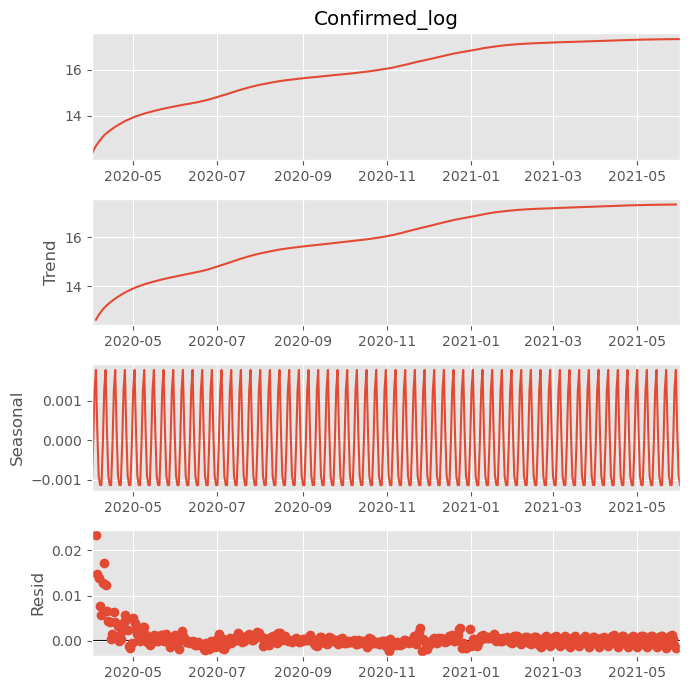

In [74]:
decomposition = seasonal_decompose(df_newcut.Confirmed_log, model = "additive")
decomposition.plot()

<AxesSubplot: xlabel='number_of_day'>

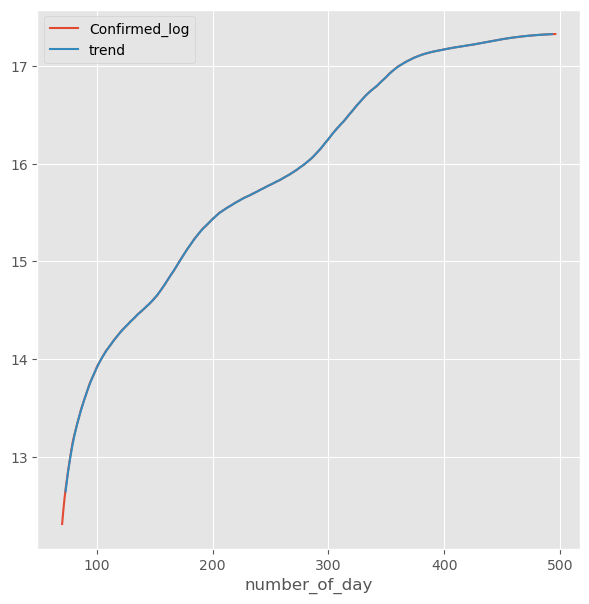

In [75]:
trend = decomposition.trend
df_newcut['trend'] = trend
df_newcut.plot(kind="line", x="number_of_day", y = ["Confirmed_log", 'trend'])

Логарифмированный ряд совпадает со своим трендом. Теперь проверим ряды на стационарность с помощью встроенного теста:

In [76]:
from statsmodels.tsa.stattools import adfuller
test = adfuller(df_newcut.Deaths)
test

(-0.28440376416543495,
 0.9276843645381285,
 16,
 410,
 {'1%': -3.4464005219454155,
  '5%': -2.868615280538588,
  '10%': -2.570538905413444},
 5787.801024007059)

Ряд не стационарный, что сразу заметно, так как нет никакой цикличности, значения просто постоянно растут. Проверим лаги:

In [77]:
df_newcut.lag1 = df_newcut.lag1.replace(0, np.nan).bfill()
df_newcut.lag11 = df_newcut.lag11.replace(0, np.nan).bfill()
test1 = adfuller(df_newcut.lag1)
test2 = adfuller(df_newcut.lag11)
test1, test2

((-1.5012645804079072,
  0.532885676562746,
  15,
  411,
  {'1%': -3.4463612216221775,
   '5%': -2.8685980017932917,
   '10%': -2.5705296947685605},
  8914.406418214685),
 (-4.283410453448663,
  0.00047453198794781415,
  14,
  412,
  {'1%': -3.4463221132914486,
   '5%': -2.8685808072418824,
   '10%': -2.570520529031954},
  8914.745265765883))

Как я и писала выше, стационарным будет ряд lag11, так как в нем четко видна близость всех значений к среднему и закономерность в изменении этих значений. Тест тоже показывает < 0.05 для этого ряда, поэтому мы отвергаем гипотезу о том, что ряд не стационарен.

Так как у нашего временного ряда нет сезонности, значения просто могут расти до бесконечности, практического смысла его прогнозировать нет, легче прогнозировать стационарный ряд, полученный разницей разниц.

#### 2.3. (8 баллов)

Для выбранного вами в предыдущем задании временного ряда и еще одного любого постройте графики ACF и PACF. Что показывают эти функции и что можно увидеть на графиках? Прокомментируйте полученные результаты: являются ли временные ряды сезонными? Видна ли на графиках длина сезонной составляющей ряда? В случае присутствия сезонности, разбейте временной ряд на повторяющиеся фрагменты и нарисуйте их наложенными для иллюстрации этой сезонности.


<AxesSubplot: title={'center': 'ACF_lag1'}>

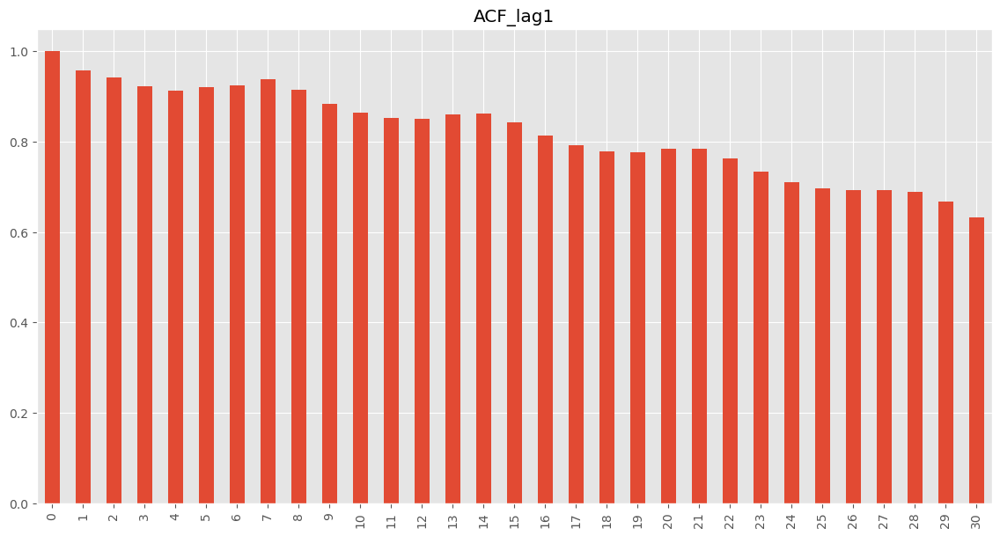

In [78]:
from statsmodels.tsa.stattools import acf, pacf
pd.Series(acf(df_newcut['lag1'],nlags=30)).plot.bar(figsize=(14,7), title='ACF_lag1')

<AxesSubplot: title={'center': 'PACF_lag1'}>

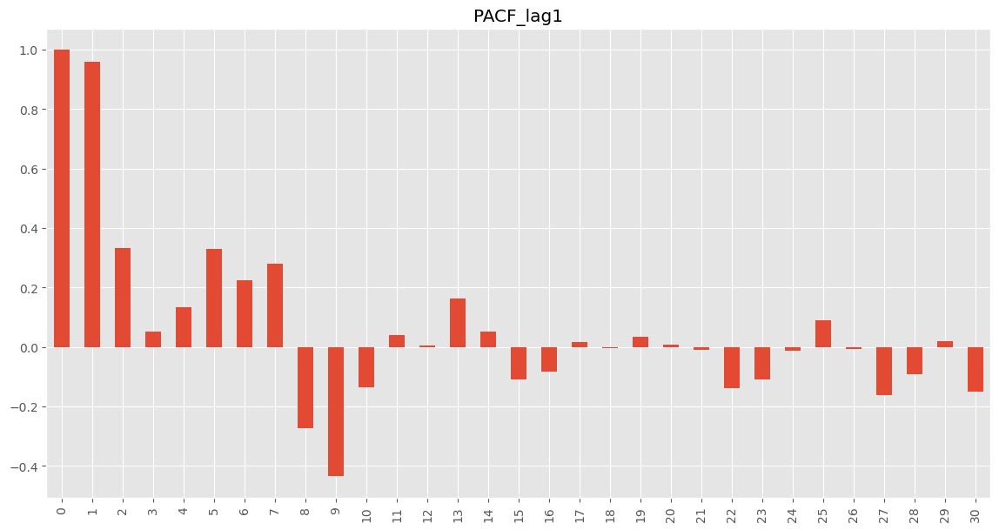

In [79]:
pd.Series(pacf(df_newcut['lag1'],nlags=30,method='ols')).plot.bar(figsize=(14,7), title='PACF_lag1')

<AxesSubplot: title={'center': 'ACF_lag11'}>

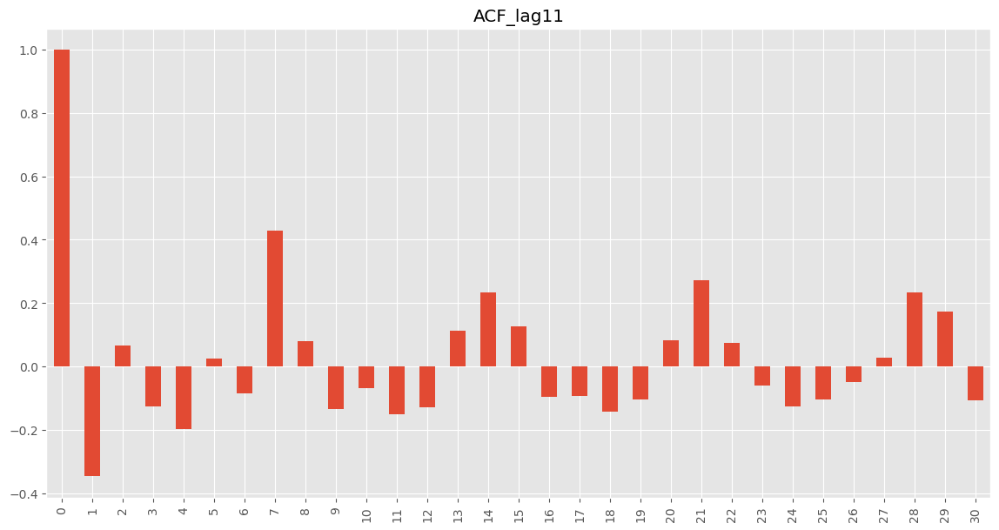

In [80]:
pd.Series(acf(df_newcut['lag11'],nlags=30)).plot.bar(figsize=(14,7), title='ACF_lag11')

<AxesSubplot: title={'center': 'PACF_lag11'}>

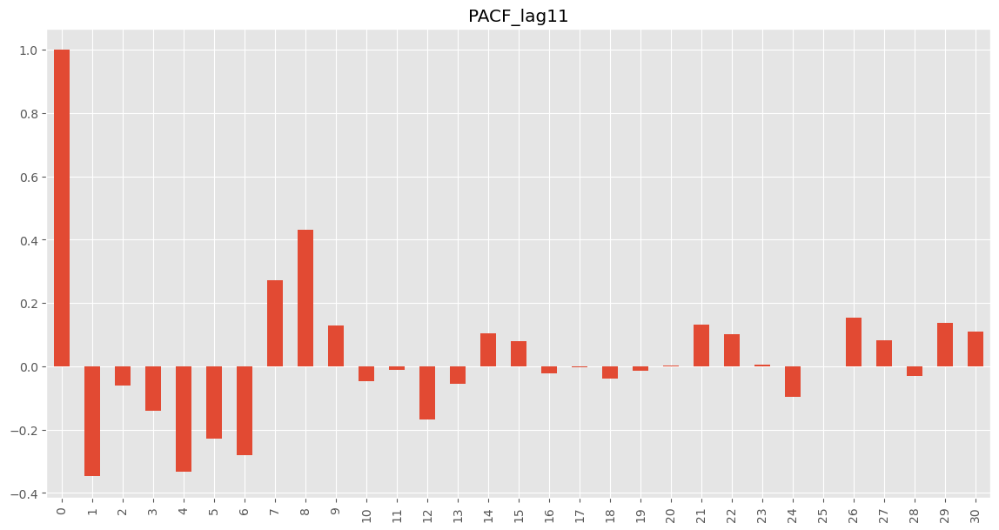

In [81]:
pd.Series(pacf(df_newcut['lag11'],nlags=30,method='ols')).plot.bar(figsize=(14,7), title='PACF_lag11')

Я построила ACF и PACF для lag1 и lag11. ACF показывает нам корреляцию между рядом и таким же рядом, сдвинутым на какое-то значение. Если максимум ACF находится в столбце, не равном 1, то ряд имеет сезонность с периодом, равным номеру столбца. Можно заметить, что ряд lag1 имеет только тренд, а ряд lag11 имеет сезонность с периодом 7, что логично, так как это стационарный ряд, а первый ряд не стационарен. PACF, которая показывает зависимость от всех предыдущих сдвигов, тоже указывает на сезонность. И если посмотреть на график для lag11 с шагом в 7, то можно заметить закономерность в изменениях значений PACF.

In [82]:
df_copy = df_newcut[['lag11','Date_x']]
df_copy['day_of_week'] = df_copy['Date_x'].dt.dayofweek
df_copy

,lag11,Date_x,day_of_week
Date_x,,,
2020-04-01,125.00,2020-04-01,2
2020-04-02,125.00,2020-04-02,3
2020-04-03,125.00,2020-04-03,4
2020-04-04,-556.00,2020-04-04,5
2020-04-05,-2605.00,2020-04-05,6
...,...,...,...
2021-05-28,-4599.00,2021-05-28,4
2021-05-29,-8933.00,2021-05-29,5
2021-05-30,-5957.00,2021-05-30,6


#### 2.4. (5 баллов)

Вспомним, что для прогнозирования временного ряда необходимо разделить выборку на две составляющие (train и test). На составляющей train наша модель обучается и настраивает свои параметры, на составляющей test модель осуществляет предсказание (а затем мы можем это предсказание сравнить с реальными данными)

Осуществите разбиение датасета на выборку train и test. Соотношение размеров train/test на ваше усмотрение, но мы советуем вам выбрать 85% на 15% или 80% на 20% (при условии, что при этом в test остаётся не менее 20-25 наблюдений).

Отрисуйте не менее 3 разных временных рядов и визуально сделайте различимым разбиение на выборки — либо вертикальной чертой, либо разными цветами.

*Подсказка. Вам может помочь раздел "Прогнозирование в будущее" в семинаре 5*

In [83]:
train, test = np.split(df_newcut, [int(.85*len(df_newcut))])
train.shape, test.shape

((362, 24), (65, 24))

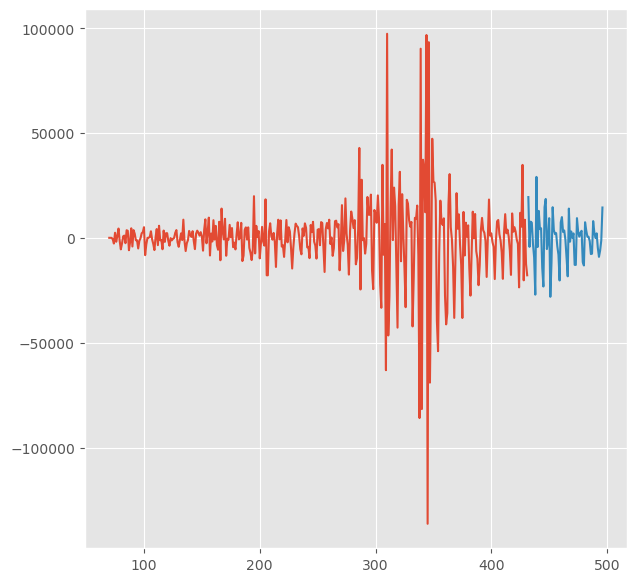

In [84]:
plt.plot(train['number_of_day'], train['lag11'])
plt.plot(test['number_of_day'], test['lag11'])

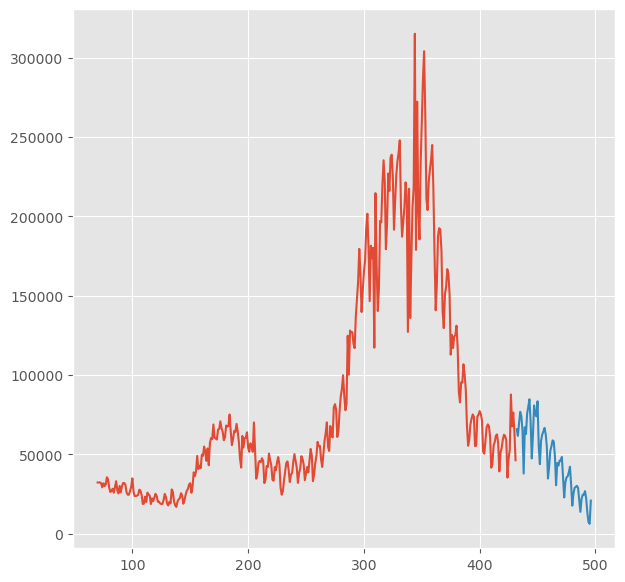

In [85]:
plt.plot(train['number_of_day'], train['lag1'])
plt.plot(test['number_of_day'], test['lag1'])

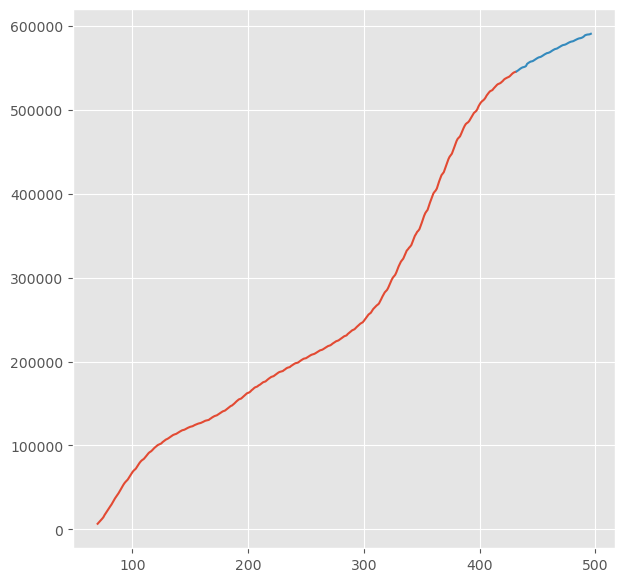

In [86]:
plt.plot(train['number_of_day'], train['Deaths'])
plt.plot(test['number_of_day'], test['Deaths'])

Я разделила выборки в соотношении 85 к 15.

## Раздел 3. Модели. Прогнозирование временных рядов (60 баллов и 58 бонусных баллов)


В этой третьей и последней части домашнего задания вам предстоит построить несколько моделей и осуществить прогнозирование для временных рядов. Прогнозирование будем делать для такого показателя как летальность от вируса. Летальность можно рассчитывать по формуле:

$$ CFR = \frac{Deaths}{Confirmed} $$

Для каждого типа модели сделайте несколько прогнозов для не менее 3 разных стран/регионов/другое (на ваш обоснованный выбор). Главное, чтобы каждый из типов моделей прознозировал одинаковый набор данных, чтобы в конце можно было сделать выводы о качестве работы той или иной модели.

В качестве метрики качества взять RMSE.

Таким образом, по итогу построения и применения **каждой из моделей** должно быть следующее:
- Вывести массив прогнозов значений (массив имеет размер test-выборки)
- Визуализировать на графике значения ряда из train-выборки одним цветом и прогнозные значения модели (из массива прогнозов) другим цветом, на одних осях
- Визуализировать на графике значения всего ряда (и из train, и из test-выборок) одним цветом и прогнозные значения модели другим цветом, на одних осях (то есть по прогнозным значениям идет наложение двух графиков - подробнее см. в семинаре 5)
- Подсчитать метрику качества по test-выборке
- Добавить результаты метрики качества в общую сводную табличку (по строкам - название модели, по столбцам - RMSE для каждого из рядов - подробнее см. в семинаре 5)

*Примечание. Данный алгоритм необходимо повторять для каждой модели, учитывая разные параметры. Иными словами ARIMA(1,0,1) и ARIMA(2,0,1) - это разные модели*

Не забывайте обязательно сопровождать ваш код комментариями, графиками и выводами.

#### 3.1. Прогнозирование средним (Mean Constant Model)  (5 баллов)

Осуществите простое прогнозирование средним значением

In [248]:
df_newcut['CFR'] = df_newcut['Deaths'] / (df_newcut['Confirmed'] + 1)
df_newcut

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,...,lag1_shift,lag11,Confirmed_log,Confirmed_log_lag,lag1_log,trend,Mean,timeIndex,Linear,CFR
Date_x,,,,,,,,,,,,,,,,,,,,,
2020-04-01,3334,2020-04-01,United States,223254,8474,6635,2020-01-22,70,208145,0.03,...,NaN,125.00,12.32,NaN,NaN,NaN,-28.63,0,44006.64,0.03
2020-04-02,3335,2020-04-02,United States,255530,9001,8142,2020-01-22,71,238387,0.03,...,NaN,125.00,12.45,12.32,0.14,NaN,-28.63,1,44165.13,0.03
2020-04-03,3336,2020-04-03,United States,287931,9707,9562,2020-01-22,72,268662,0.03,...,32276.00,125.00,12.57,12.45,0.12,NaN,-28.63,2,44323.63,0.03
2020-04-04,3337,2020-04-04,United States,319776,14652,11165,2020-01-22,73,293959,0.03,...,32401.00,-556.00,12.68,12.57,0.10,12.65,-28.63,3,44482.13,0.03
2020-04-05,3338,2020-04-05,United States,349016,17448,12781,2020-01-22,74,318787,0.04,...,31845.00,-2605.00,12.76,12.68,0.09,12.75,-28.63,4,44640.62,0.04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-28,3756,2021-05-28,United States,33349400,0,589535,2020-01-22,492,32759865,0.02,...,26843.00,-4599.00,17.32,17.32,0.00,17.32,-28.63,422,110892.01,0.02
2021-05-29,3757,2021-05-29,United States,33362711,0,589878,2020-01-22,493,32772833,0.02,...,22244.00,-8933.00,17.32,17.32,0.00,17.32,-28.63,423,111050.50,0.02
2021-05-30,3758,2021-05-30,United States,33370065,0,590027,2020-01-22,494,32780038,0.02,...,13311.00,-5957.00,17.32,17.32,0.00,NaN,-28.63,424,111209.00,0.02


In [249]:
df_newcut['CFR_lag1'] = df_newcut.CFR.shift()
df_newcut["lag1"] = df_newcut.CFR - df_newcut.CFR_lag1
df_newcut['lag1_shift'] = df_newcut.lag1.shift()
df_newcut["lag11"] = df_newcut.lag1 - df_newcut.lag1_shift
df_newcut

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,...,lag11,Confirmed_log,Confirmed_log_lag,lag1_log,trend,Mean,timeIndex,Linear,CFR,CFR_lag1
Date_x,,,,,,,,,,,,,,,,,,,,,
2020-04-01,3334,2020-04-01,United States,223254,8474,6635,2020-01-22,70,208145,0.03,...,NaN,12.32,NaN,NaN,NaN,-28.63,0,44006.64,0.03,NaN
2020-04-02,3335,2020-04-02,United States,255530,9001,8142,2020-01-22,71,238387,0.03,...,NaN,12.45,12.32,0.14,NaN,-28.63,1,44165.13,0.03,0.03
2020-04-03,3336,2020-04-03,United States,287931,9707,9562,2020-01-22,72,268662,0.03,...,-0.00,12.57,12.45,0.12,NaN,-28.63,2,44323.63,0.03,0.03
2020-04-04,3337,2020-04-04,United States,319776,14652,11165,2020-01-22,73,293959,0.03,...,0.00,12.68,12.57,0.10,12.65,-28.63,3,44482.13,0.03,0.03
2020-04-05,3338,2020-04-05,United States,349016,17448,12781,2020-01-22,74,318787,0.04,...,-0.00,12.76,12.68,0.09,12.75,-28.63,4,44640.62,0.04,0.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-28,3756,2021-05-28,United States,33349400,0,589535,2020-01-22,492,32759865,0.02,...,-0.00,17.32,17.32,0.00,17.32,-28.63,422,110892.01,0.02,0.02
2021-05-29,3757,2021-05-29,United States,33362711,0,589878,2020-01-22,493,32772833,0.02,...,-0.00,17.32,17.32,0.00,17.32,-28.63,423,111050.50,0.02,0.02
2021-05-30,3758,2021-05-30,United States,33370065,0,590027,2020-01-22,494,32780038,0.02,...,-0.00,17.32,17.32,0.00,NaN,-28.63,424,111209.00,0.02,0.02


<AxesSubplot: title={'center': 'USA'}, xlabel='number_of_day'>

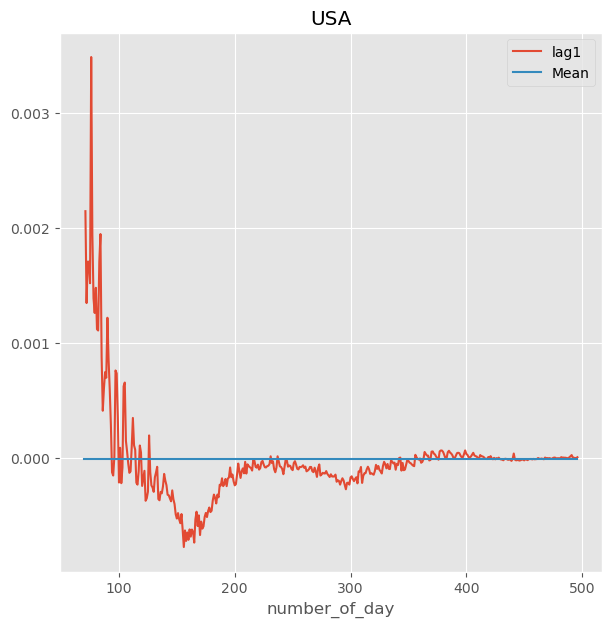

In [250]:
model_mean_pred = df_newcut.lag11.mean()
df_newcut["Mean"] = model_mean_pred
df_newcut.plot(kind="line", x= 'number_of_day', y = ["lag1", "Mean"], title = 'USA')

In [251]:
df_newcut1 = df_cut[df_cut['Country'] == 'China'].reset_index()
df_newcut1['CFR'] = df_newcut1['Deaths'] / (df_newcut1['Confirmed'] + 1)
df_newcut1['CFR_lag1'] = df_newcut1.CFR.shift()
df_newcut1["lag1"] = df_newcut1.CFR - df_newcut1.CFR_lag1
df_newcut1['lag1_shift'] = df_newcut1.lag1.shift()
df_newcut1["lag11"] = df_newcut1.lag1 - df_newcut1.lag1_shift
df_newcut1

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,CFR,CFR_lag1,lag1,lag1_shift,lag11
0,70,2020-04-01,China,84002,76405,3316,2020-01-22,70,4281,0.04,0.04,NaN,NaN,NaN,NaN
1,71,2020-04-02,China,84129,76565,3322,2020-01-22,71,4242,0.04,0.04,0.04,0.00,NaN,NaN
2,72,2020-04-03,China,84265,76760,3326,2020-01-22,72,4179,0.04,0.04,0.04,-0.00,0.00,-0.00
3,73,2020-04-04,China,84363,76946,3330,2020-01-22,73,4087,0.04,0.04,0.04,0.00,-0.00,0.00
4,74,2020-04-05,China,84467,77207,3333,2020-01-22,74,3927,0.04,0.04,0.04,-0.00,0.00,-0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
422,492,2021-05-28,China,112183,97726,4846,2020-01-22,492,9611,0.04,0.04,0.04,-0.00,-0.00,-0.00
423,493,2021-05-29,China,112207,97737,4846,2020-01-22,493,9624,0.04,0.04,0.04,-0.00,-0.00,0.00
424,494,2021-05-30,China,112256,97756,4846,2020-01-22,494,9654,0.04,0.04,0.04,-0.00,-0.00,-0.00
425,495,2021-05-31,China,112286,97770,4846,2020-01-22,495,9670,0.04,0.04,0.04,-0.00,-0.00,0.00


<AxesSubplot: title={'center': 'China'}, xlabel='number_of_day'>

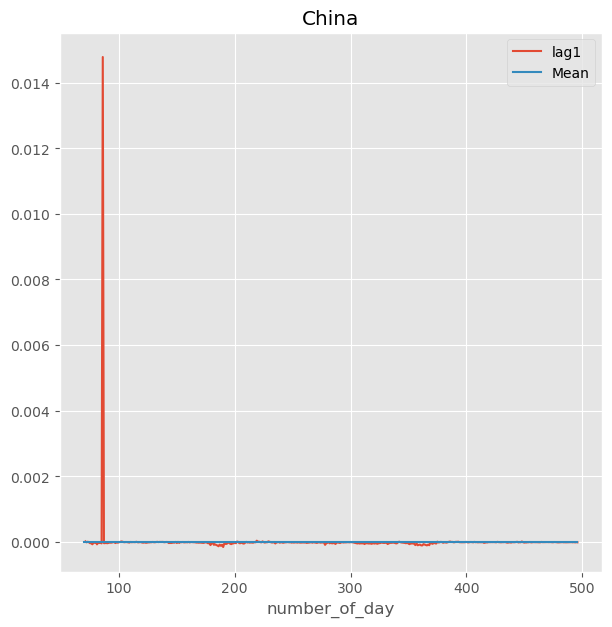

In [252]:
model_mean_pred = df_newcut1.lag11.mean()
df_newcut1["Mean"] = model_mean_pred
df_newcut1.plot(kind="line", x= 'number_of_day', y = ["lag1", "Mean"], title = 'China')

In [253]:
df_newcut2 = df_cut[df_cut['Country'] == 'Russian Federation'].reset_index()
df_newcut2['CFR'] = df_newcut2['Deaths'] / (df_newcut2['Confirmed'] + 1)
df_newcut2['CFR_lag1'] = df_newcut2.CFR.shift()
df_newcut2["lag1"] = df_newcut2.CFR - df_newcut2.CFR_lag1
df_newcut2['lag1_shift'] = df_newcut2.lag1.shift()
df_newcut2["lag11"] = df_newcut2.lag1 - df_newcut2.lag1_shift
df_newcut2

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,CFR,CFR_lag1,lag1,lag1_shift,lag11
0,16321,2020-04-10,Russian Federation,11917,795,94,2020-01-31,70,11028,0.01,0.01,NaN,NaN,NaN,NaN
1,16322,2020-04-11,Russian Federation,13584,1045,106,2020-01-31,71,12433,0.01,0.01,0.01,-0.00,NaN,NaN
2,16323,2020-04-12,Russian Federation,15770,1291,130,2020-01-31,72,14349,0.01,0.01,0.01,0.00,-0.00,0.00
3,16324,2020-04-13,Russian Federation,18328,1470,148,2020-01-31,73,16710,0.01,0.01,0.01,-0.00,0.00,-0.00
4,16325,2020-04-14,Russian Federation,21102,1694,170,2020-01-31,74,19238,0.01,0.01,0.01,-0.00,-0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
413,16734,2021-05-28,Russian Federation,4986458,4607276,118386,2020-01-31,483,260796,0.02,0.02,0.02,0.00,0.00,-0.00
414,16735,2021-05-29,Russian Federation,4995613,4616422,118781,2020-01-31,484,260410,0.02,0.02,0.02,0.00,0.00,-0.00
415,16736,2021-05-30,Russian Federation,5005171,4623764,119130,2020-01-31,485,262277,0.02,0.02,0.02,0.00,0.00,-0.00
416,16737,2021-05-31,Russian Federation,5013512,4630461,119464,2020-01-31,486,263587,0.02,0.02,0.02,0.00,0.00,0.00


<AxesSubplot: title={'center': 'Russia'}, xlabel='number_of_day'>

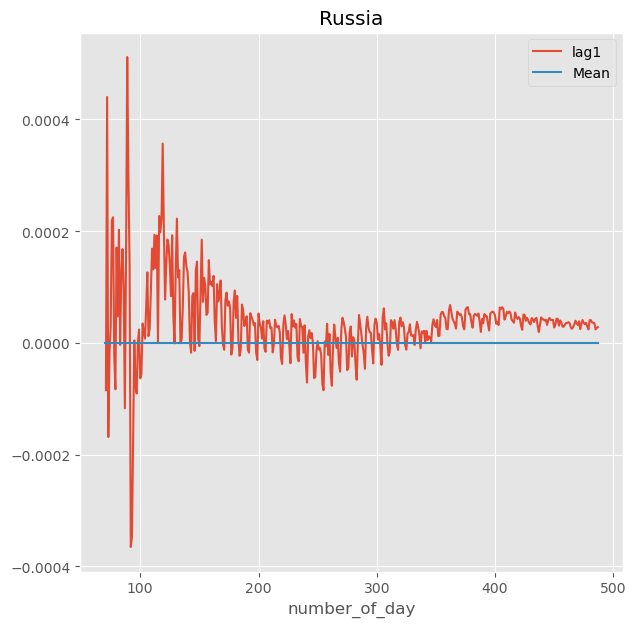

In [254]:
model_mean_pred = df_newcut2.lag11.mean()
df_newcut2["Mean"] = model_mean_pred
df_newcut2.plot(kind="line", x= 'number_of_day', y = ["lag1", "Mean"], title = 'Russia')

In [255]:
def RMSE(predicted, actual):
    mse = (predicted - actual)**2
    rmse = np.sqrt(mse.sum()/mse.count())
    return rmse

In [256]:
model_mean_RMSE = RMSE(df_newcut.Mean, df_newcut.lag1)
model_mean_RMSE

0.000402603844315352

In [257]:
dfResults = pd.DataFrame(columns = ["Model", "RMSE"])
dfResults.head()

,Model,RMSE


In [258]:
dfResults.loc[0,"Model"] = "Mean_USA"
dfResults.loc[0,"RMSE"] = model_mean_RMSE
dfResults.head()

,Model,RMSE
0,Mean_USA,0.00


In [259]:
model_mean_RMSE1 = RMSE(df_newcut1.Mean, df_newcut1.lag1)
model_mean_RMSE1

0.0007170040984517728

In [260]:
dfResults.loc[1,"Model"] = "Mean_China"
dfResults.loc[1,"RMSE"] = model_mean_RMSE1
dfResults.head()

,Model,RMSE
0,Mean_USA,0.00
1,Mean_China,0.00


In [261]:
model_mean_RMSE2 = RMSE(df_newcut2.Mean, df_newcut2.lag1)
model_mean_RMSE2

8.061393646947715e-05

In [262]:
dfResults.loc[2,"Model"] = "Mean_Russia"
dfResults.loc[2,"RMSE"] = model_mean_RMSE2
dfResults.head()

,Model,RMSE
0,Mean_USA,0.00
1,Mean_China,0.00
2,Mean_Russia,0.00


#### 3.2. Линейная модель (Linear Trend Model) (5 баллов)

Осуществите предсказание с помощью линейного тренда

In [263]:
df_newcut["timeIndex"] = df_newcut["number_of_day"] - 70
df_newcut

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,...,lag11,Confirmed_log,Confirmed_log_lag,lag1_log,trend,Mean,timeIndex,Linear,CFR,CFR_lag1
Date_x,,,,,,,,,,,,,,,,,,,,,
2020-04-01,3334,2020-04-01,United States,223254,8474,6635,2020-01-22,70,208145,0.03,...,NaN,12.32,NaN,NaN,NaN,-0.00,0,44006.64,0.03,NaN
2020-04-02,3335,2020-04-02,United States,255530,9001,8142,2020-01-22,71,238387,0.03,...,NaN,12.45,12.32,0.14,NaN,-0.00,1,44165.13,0.03,0.03
2020-04-03,3336,2020-04-03,United States,287931,9707,9562,2020-01-22,72,268662,0.03,...,-0.00,12.57,12.45,0.12,NaN,-0.00,2,44323.63,0.03,0.03
2020-04-04,3337,2020-04-04,United States,319776,14652,11165,2020-01-22,73,293959,0.03,...,0.00,12.68,12.57,0.10,12.65,-0.00,3,44482.13,0.03,0.03
2020-04-05,3338,2020-04-05,United States,349016,17448,12781,2020-01-22,74,318787,0.04,...,-0.00,12.76,12.68,0.09,12.75,-0.00,4,44640.62,0.04,0.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-28,3756,2021-05-28,United States,33349400,0,589535,2020-01-22,492,32759865,0.02,...,-0.00,17.32,17.32,0.00,17.32,-0.00,422,110892.01,0.02,0.02
2021-05-29,3757,2021-05-29,United States,33362711,0,589878,2020-01-22,493,32772833,0.02,...,-0.00,17.32,17.32,0.00,17.32,-0.00,423,111050.50,0.02,0.02
2021-05-30,3758,2021-05-30,United States,33370065,0,590027,2020-01-22,494,32780038,0.02,...,-0.00,17.32,17.32,0.00,NaN,-0.00,424,111209.00,0.02,0.02


In [264]:
import statsmodels.formula.api as smf
model_linear = smf.ols('lag1 ~ timeIndex', data = df_newcut).fit()
c = model_linear.params[0]
m = model_linear.params[1]
c,m

(6.404213645426943e-05, -4.322139689203873e-07)

In [268]:
model_linear_pred = model_linear.predict()
model_linear_pred = np.append(model_linear_pred,model_linear_pred[len(model_linear_pred)-1])
len(model_linear_pred)

427

In [269]:
df_newcut["Linear"] = model_linear_pred

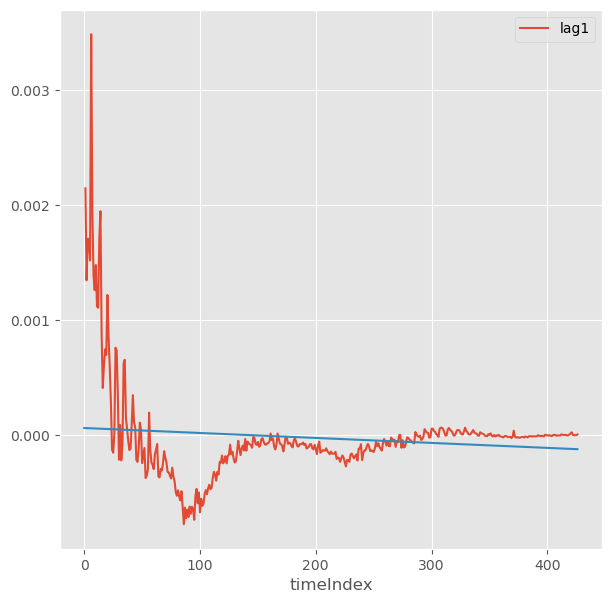

In [270]:
df_newcut.plot(kind="line", x="timeIndex", y = "lag1")
plt.plot(df_newcut.timeIndex,model_linear_pred, '-')

In [271]:
df_newcut1["timeIndex"] = df_newcut1["number_of_day"] - 70
df_newcut1

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,CFR,CFR_lag1,lag1,lag1_shift,lag11,Mean,timeIndex
0,70,2020-04-01,China,84002,76405,3316,2020-01-22,70,4281,0.04,0.04,NaN,NaN,NaN,NaN,-0.00,0
1,71,2020-04-02,China,84129,76565,3322,2020-01-22,71,4242,0.04,0.04,0.04,0.00,NaN,NaN,-0.00,1
2,72,2020-04-03,China,84265,76760,3326,2020-01-22,72,4179,0.04,0.04,0.04,-0.00,0.00,-0.00,-0.00,2
3,73,2020-04-04,China,84363,76946,3330,2020-01-22,73,4087,0.04,0.04,0.04,0.00,-0.00,0.00,-0.00,3
4,74,2020-04-05,China,84467,77207,3333,2020-01-22,74,3927,0.04,0.04,0.04,-0.00,0.00,-0.00,-0.00,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
422,492,2021-05-28,China,112183,97726,4846,2020-01-22,492,9611,0.04,0.04,0.04,-0.00,-0.00,-0.00,-0.00,422
423,493,2021-05-29,China,112207,97737,4846,2020-01-22,493,9624,0.04,0.04,0.04,-0.00,-0.00,0.00,-0.00,423
424,494,2021-05-30,China,112256,97756,4846,2020-01-22,494,9654,0.04,0.04,0.04,-0.00,-0.00,-0.00,-0.00,424
425,495,2021-05-31,China,112286,97770,4846,2020-01-22,495,9670,0.04,0.04,0.04,-0.00,-0.00,0.00,-0.00,425


In [272]:
model_linear = smf.ols('lag1 ~ timeIndex', data = df_newcut1).fit()
c = model_linear.params[0]
m = model_linear.params[1]
c,m

(0.000101649184140475, -4.358015534764379e-07)

In [273]:
model_linear_pred = model_linear.predict()
model_linear_pred = np.append(model_linear_pred,model_linear_pred[len(model_linear_pred)-1])
len(model_linear_pred)

427

In [274]:
df_newcut1["Linear"] = model_linear_pred

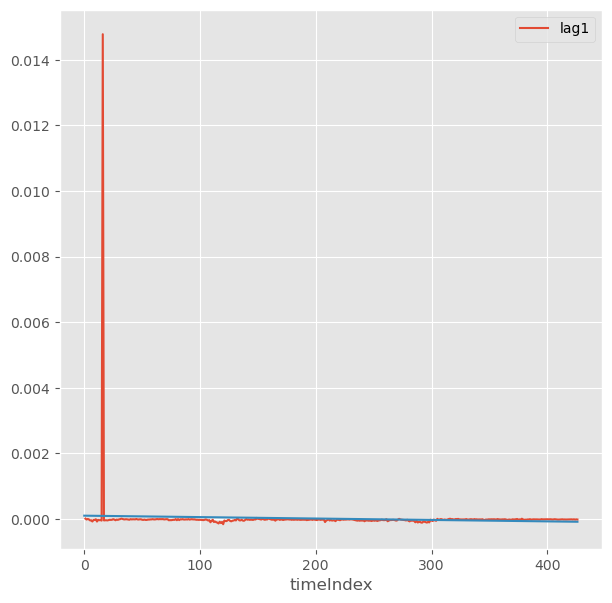

In [275]:
df_newcut1.plot(kind="line", x="timeIndex", y = "lag1")
plt.plot(df_newcut1.timeIndex,model_linear_pred, '-')

In [276]:
df_newcut2["timeIndex"] = df_newcut2["number_of_day"] - 70
df_newcut2

,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,CFR,CFR_lag1,lag1,lag1_shift,lag11,Mean,timeIndex
0,16321,2020-04-10,Russian Federation,11917,795,94,2020-01-31,70,11028,0.01,0.01,NaN,NaN,NaN,NaN,0.00,0
1,16322,2020-04-11,Russian Federation,13584,1045,106,2020-01-31,71,12433,0.01,0.01,0.01,-0.00,NaN,NaN,0.00,1
2,16323,2020-04-12,Russian Federation,15770,1291,130,2020-01-31,72,14349,0.01,0.01,0.01,0.00,-0.00,0.00,0.00,2
3,16324,2020-04-13,Russian Federation,18328,1470,148,2020-01-31,73,16710,0.01,0.01,0.01,-0.00,0.00,-0.00,0.00,3
4,16325,2020-04-14,Russian Federation,21102,1694,170,2020-01-31,74,19238,0.01,0.01,0.01,-0.00,-0.00,0.00,0.00,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
413,16734,2021-05-28,Russian Federation,4986458,4607276,118386,2020-01-31,483,260796,0.02,0.02,0.02,0.00,0.00,-0.00,0.00,413
414,16735,2021-05-29,Russian Federation,4995613,4616422,118781,2020-01-31,484,260410,0.02,0.02,0.02,0.00,0.00,-0.00,0.00,414
415,16736,2021-05-30,Russian Federation,5005171,4623764,119130,2020-01-31,485,262277,0.02,0.02,0.02,0.00,0.00,-0.00,0.00,415
416,16737,2021-05-31,Russian Federation,5013512,4630461,119464,2020-01-31,486,263587,0.02,0.02,0.02,0.00,0.00,0.00,0.00,416


In [277]:
model_linear = smf.ols('lag1 ~ timeIndex', data = df_newcut2).fit()
c = model_linear.params[0]
m = model_linear.params[1]
c,m

(5.8151751744176056e-05, -9.500175825028958e-08)

In [278]:
model_linear_pred = model_linear.predict()
model_linear_pred = np.append(model_linear_pred,model_linear_pred[len(model_linear_pred)-1])
len(model_linear_pred)

418

In [279]:
df_newcut2["Linear"] = model_linear_pred

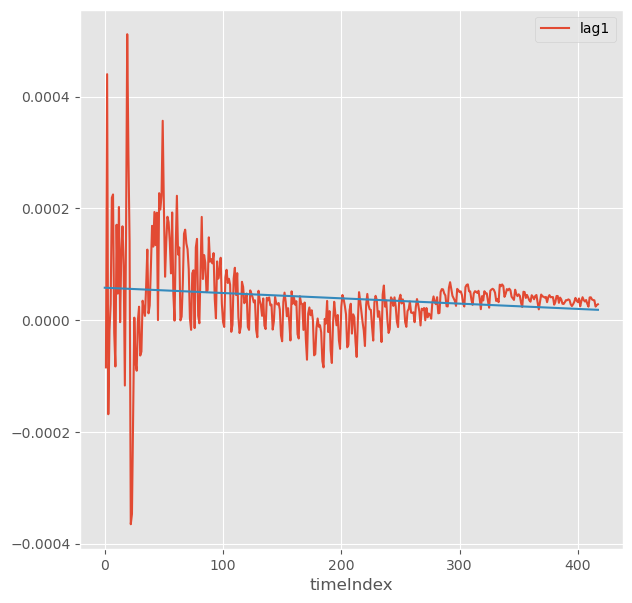

In [280]:
df_newcut2.plot(kind="line", x="timeIndex", y = "lag1")
plt.plot(df_newcut2.timeIndex,model_linear_pred, '-')

In [281]:
model_linear_RMSE = RMSE(df_newcut.Linear, df_newcut.lag1)
model_linear_RMSE

0.0003984042874274634

In [282]:
dfResults.loc[3,"Model"] = "Linear_USA"
dfResults.loc[3,"RMSE"] = model_linear_RMSE
dfResults.head()

,Model,RMSE
0,Mean_USA,0.00
1,Mean_China,0.00
2,Mean_Russia,0.00
3,Linear_USA,0.00


In [283]:
model_linear_RMSE1 = RMSE(df_newcut1.Linear, df_newcut1.lag1)
model_linear_RMSE1

0.0007149458266560293

In [284]:
dfResults.loc[4,"Model"] = "Linear_China"
dfResults.loc[4,"RMSE"] = model_linear_RMSE1
dfResults.head()

,Model,RMSE
0,Mean_USA,0.00
1,Mean_China,0.00
2,Mean_Russia,0.00
3,Linear_USA,0.00
4,Linear_China,0.00


In [285]:
model_linear_RMSE2 = RMSE(df_newcut2.Linear, df_newcut2.lag1)
model_linear_RMSE2

7.01564897011893e-05

In [286]:
dfResults.loc[5,"Model"] = "Linear_Russia"
dfResults.loc[5,"RMSE"] = model_linear_RMSE2
dfResults

,Model,RMSE
0,Mean_USA,0.00
1,Mean_China,0.00
2,Mean_Russia,0.00
3,Linear_USA,0.00
4,Linear_China,0.00
5,Linear_Russia,0.00


#### 3.3. Скользящее среднее (MA - Moving average) (5 баллов)

Постройте предсказание с помощью модели MA. Обязательно поэкспериментируйте с гиперпараметрами модели (и опишите, что вы делаете)

In [293]:
from statsmodels.tsa.arima.model import ARIMA

<AxesSubplot: title={'center': 'ACF_USA'}>

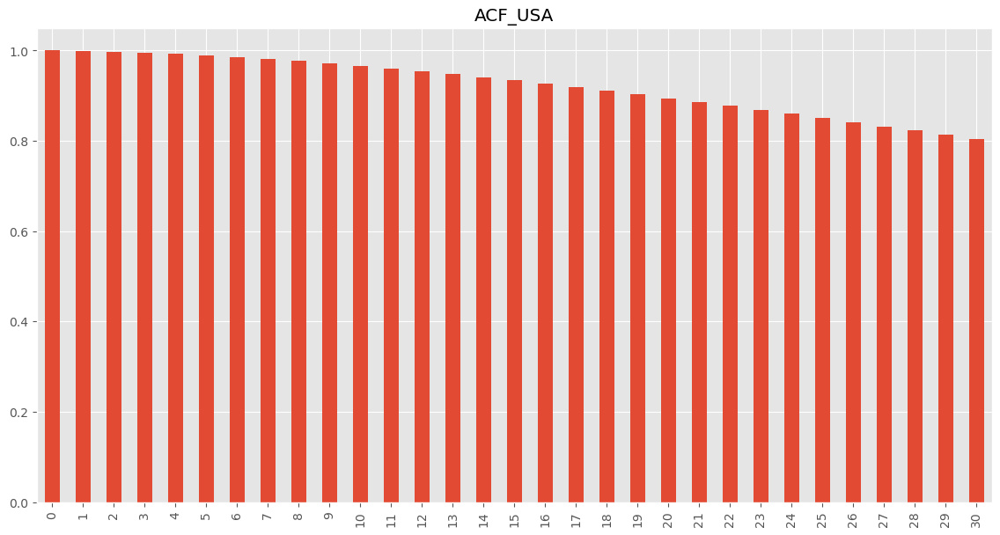

In [294]:
pd.Series(acf(df_newcut['CFR'],nlags=30)).plot.bar(figsize=(14,7), title='ACF_USA')

In [307]:
ARMA_model = ARIMA(endog=df_newcut['lag1'], order=(0, 0, 1))
results = ARMA_model.fit()
df_newcut

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.



,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,...,Confirmed_log,Confirmed_log_lag,lag1_log,trend,Mean,timeIndex,Linear,CFR,CFR_lag1,forecast
Date_x,,,,,,,,,,,,,,,,,,,,,
2020-04-01,3334,2020-04-01,United States,223254,8474,6635,2020-01-22,70,208145,0.03,...,12.32,NaN,NaN,NaN,-0.00,0,0.00,0.03,NaN,-0.00
2020-04-02,3335,2020-04-02,United States,255530,9001,8142,2020-01-22,71,238387,0.03,...,12.45,12.32,0.14,NaN,-0.00,1,0.00,0.03,0.03,-0.00
2020-04-03,3336,2020-04-03,United States,287931,9707,9562,2020-01-22,72,268662,0.03,...,12.57,12.45,0.12,NaN,-0.00,2,0.00,0.03,0.03,0.00
2020-04-04,3337,2020-04-04,United States,319776,14652,11165,2020-01-22,73,293959,0.03,...,12.68,12.57,0.10,12.65,-0.00,3,0.00,0.03,0.03,0.00
2020-04-05,3338,2020-04-05,United States,349016,17448,12781,2020-01-22,74,318787,0.04,...,12.76,12.68,0.09,12.75,-0.00,4,0.00,0.04,0.03,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-28,3756,2021-05-28,United States,33349400,0,589535,2020-01-22,492,32759865,0.02,...,17.32,17.32,0.00,17.32,-0.00,422,-0.00,0.02,0.02,-0.00
2021-05-29,3757,2021-05-29,United States,33362711,0,589878,2020-01-22,493,32772833,0.02,...,17.32,17.32,0.00,17.32,-0.00,423,-0.00,0.02,0.02,-0.00
2021-05-30,3758,2021-05-30,United States,33370065,0,590027,2020-01-22,494,32780038,0.02,...,17.32,17.32,0.00,NaN,-0.00,424,-0.00,0.02,0.02,-0.00


In [296]:
start_date = df_newcut.Date_x.min()
end_date= df_newcut.Date_x.max()
df_newcut['forecast'] = results.predict(start=start_date, end=end_date)

<AxesSubplot: xlabel='Date_x'>

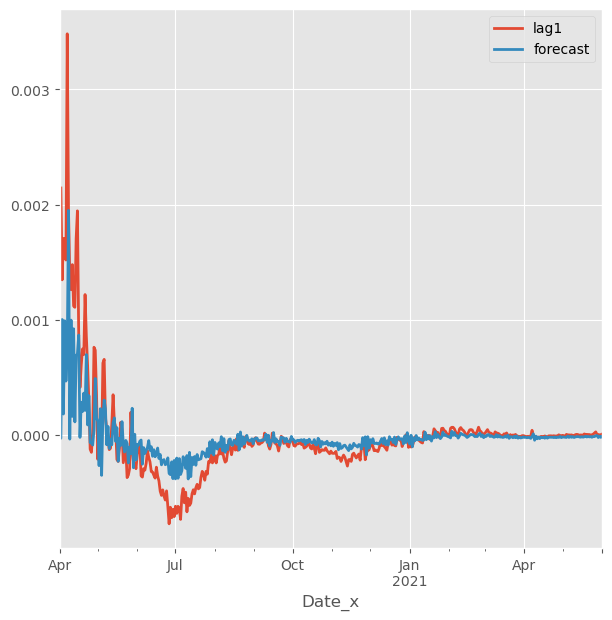

In [297]:
df_newcut[['lag1','forecast']].plot(lw=2)

<AxesSubplot: title={'center': 'ACF_China'}>

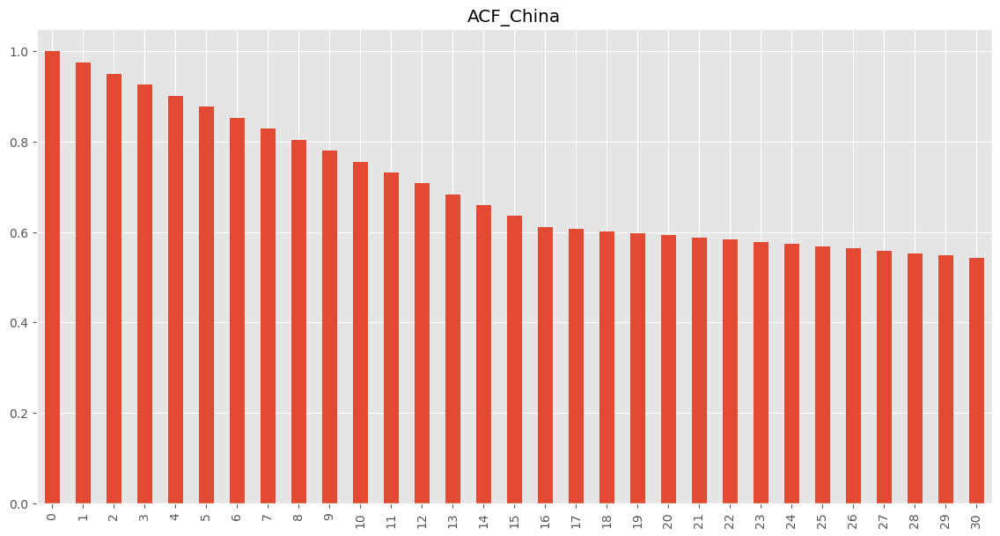

In [298]:
pd.Series(acf(df_newcut1['CFR'],nlags=30)).plot.bar(figsize=(14,7), title='ACF_China')

In [313]:
ARMA_model = ARIMA(endog=df_newcut1['lag1'], order=(0, 0, 1))
results = ARMA_model.fit()
df_newcut1 = df_newcut1.set_index(df_newcut.Date_x)
df_newcut1

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,CFR,CFR_lag1,lag1,lag1_shift,lag11,Mean,timeIndex,Linear
Date_x,,,,,,,,,,,,,,,,,,
2020-04-01,70,2020-04-01,China,84002,76405,3316,2020-01-22,70,4281,0.04,0.04,NaN,NaN,NaN,NaN,-0.00,0,0.00
2020-04-02,71,2020-04-02,China,84129,76565,3322,2020-01-22,71,4242,0.04,0.04,0.04,0.00,NaN,NaN,-0.00,1,0.00
2020-04-03,72,2020-04-03,China,84265,76760,3326,2020-01-22,72,4179,0.04,0.04,0.04,-0.00,0.00,-0.00,-0.00,2,0.00
2020-04-04,73,2020-04-04,China,84363,76946,3330,2020-01-22,73,4087,0.04,0.04,0.04,0.00,-0.00,0.00,-0.00,3,0.00
2020-04-05,74,2020-04-05,China,84467,77207,3333,2020-01-22,74,3927,0.04,0.04,0.04,-0.00,0.00,-0.00,-0.00,4,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-28,492,2021-05-28,China,112183,97726,4846,2020-01-22,492,9611,0.04,0.04,0.04,-0.00,-0.00,-0.00,-0.00,422,-0.00
2021-05-29,493,2021-05-29,China,112207,97737,4846,2020-01-22,493,9624,0.04,0.04,0.04,-0.00,-0.00,0.00,-0.00,423,-0.00
2021-05-30,494,2021-05-30,China,112256,97756,4846,2020-01-22,494,9654,0.04,0.04,0.04,-0.00,-0.00,-0.00,-0.00,424,-0.00


In [314]:
start_date = df_newcut1.Date_x.min()
end_date= df_newcut1.Date_x.max()
df_newcut1['forecast'] = results.predict(start=start_date, end=end_date)

<AxesSubplot: xlabel='Date_x'>

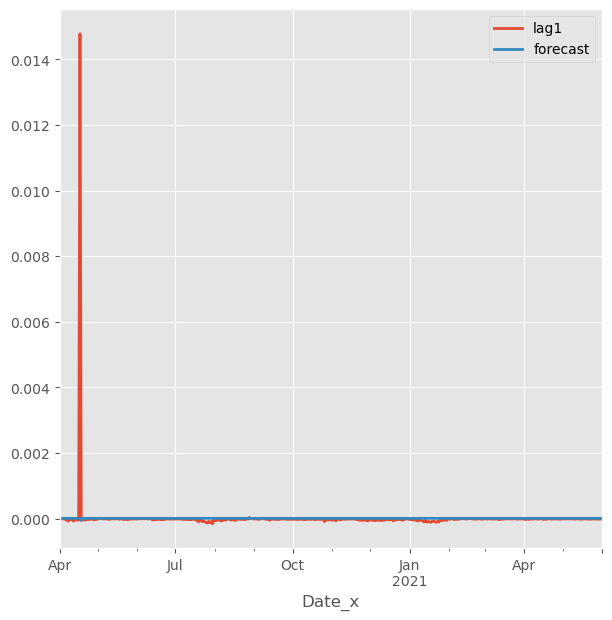

In [315]:
df_newcut1[['lag1','forecast']].plot(lw=2)

<AxesSubplot: title={'center': 'ACF_Russia'}>

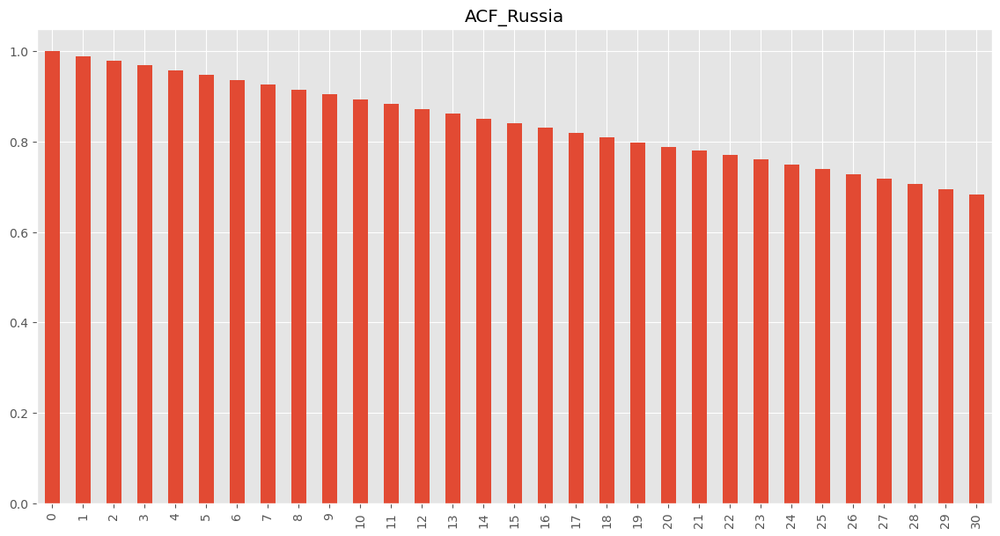

In [316]:
pd.Series(acf(df_newcut2['CFR'],nlags=30)).plot.bar(figsize=(14,7), title='ACF_Russia')

In [320]:
ARMA_model = ARIMA(endog=df_newcut2['lag1'], order=(0, 0, 1))
results = ARMA_model.fit()
df_newcut2 = df_newcut2.set_index(df_newcut2.Date_x)
df_newcut2

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency D will be used.

C:\Users\argen\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



,index,Date_x,Country,Confirmed,Recovered,Deaths,first_day,number_of_day,ill,Deaths/Confirmed,CFR,CFR_lag1,lag1,lag1_shift,lag11,Mean,timeIndex,Linear
Date_x,,,,,,,,,,,,,,,,,,
2020-04-10,16321,2020-04-10,Russian Federation,11917,795,94,2020-01-31,70,11028,0.01,0.01,NaN,NaN,NaN,NaN,0.00,0,0.00
2020-04-11,16322,2020-04-11,Russian Federation,13584,1045,106,2020-01-31,71,12433,0.01,0.01,0.01,-0.00,NaN,NaN,0.00,1,0.00
2020-04-12,16323,2020-04-12,Russian Federation,15770,1291,130,2020-01-31,72,14349,0.01,0.01,0.01,0.00,-0.00,0.00,0.00,2,0.00
2020-04-13,16324,2020-04-13,Russian Federation,18328,1470,148,2020-01-31,73,16710,0.01,0.01,0.01,-0.00,0.00,-0.00,0.00,3,0.00
2020-04-14,16325,2020-04-14,Russian Federation,21102,1694,170,2020-01-31,74,19238,0.01,0.01,0.01,-0.00,-0.00,0.00,0.00,4,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-28,16734,2021-05-28,Russian Federation,4986458,4607276,118386,2020-01-31,483,260796,0.02,0.02,0.02,0.00,0.00,-0.00,0.00,413,0.00
2021-05-29,16735,2021-05-29,Russian Federation,4995613,4616422,118781,2020-01-31,484,260410,0.02,0.02,0.02,0.00,0.00,-0.00,0.00,414,0.00
2021-05-30,16736,2021-05-30,Russian Federation,5005171,4623764,119130,2020-01-31,485,262277,0.02,0.02,0.02,0.00,0.00,-0.00,0.00,415,0.00


In [323]:
start_date = df_newcut2.Date_x.min()
end_date= df_newcut2.Date_x.max()
df_newcut2['forecast'] = results.predict(start=start_date, end=end_date)

<AxesSubplot: xlabel='Date_x'>

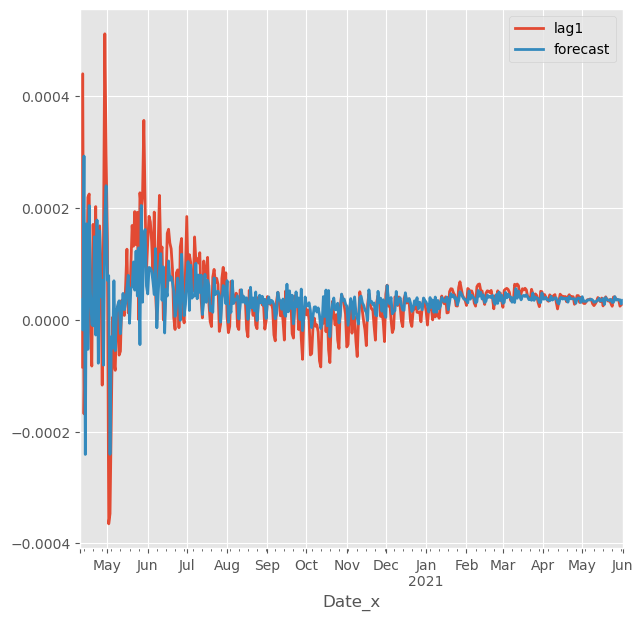

In [324]:
df_newcut2[['lag1','forecast']].plot(lw=2)